# Preprocessing

In this script a preprocessing pipeline for EEG signals is presented. It consists of the following steps:
1. Band-pass filtering 4-100Hz
2. Notch filtering 50Hz
3. Band-pass filtering 4-100Hz
4. ICA to eliminate EOG and ECG if possible
5. Separating the signals in videos
6. Noise removal with threshold mean+5*STD
7. Creating 4 s epochs
8. Normalizing per channel and user
9. Feature extraction

### To use this script please install:

Anaconda Prompt - 

pip install mne

To use feature_extraction update sklearn (>1.0) and make the change mentioned in 
https://github.com/mne-tools/mne-features/pull/70/commits/629f5d48f03e5facf0280c989b26cbebab4d199d

In [1]:
import numpy as np, matplotlib.pyplot as plt, pandas as pd, statistics as sts
import os, shutil, scipy, pathlib, json, mne, mne_features

from mne.preprocessing import (ICA, create_eog_epochs, create_ecg_epochs, corrmap)
from mne import io
from mne_features.feature_extraction import extract_features

from sklearn.decomposition import PCA, FastICA
from sklearn.preprocessing import StandardScaler

from scipy.stats import differential_entropy


In [2]:
# Dataframe for our own data, to select a user and know the order the videos were presented to her

df_vols = pd.DataFrame(index = range(29), columns=['Voluntaria', 'Video1', 'Video2', 'Video3', 'Video4', 'Video5', 
                                                   'Video6', 'Video7', 'Video8', 'Video9', 'Video10', 'Video11', 
                                                   'Video12', 'Video13', 'Video14', 'Video1_emo', 'Video2_emo', 
                                                   'Video3_emo', 'Video4_emo', 'Video5_emo', 'Video6_emo', 
                                                   'Video7_emo', 'Video8_emo', 'Video9_emo','Video10_emo', 
                                                   'Video11_emo', 'Video12_emo', 'Video13_emo', 'Video14_emo'])

vols_G = [1, 2, 4, 6, 8, 9, 10, 11, 12, 13, 18, 19, 20, 22, 23, 24, 25, 26, 27, 28, 29]
vols_1 = [3, 4, 5, 7, 8, 11, 16, 22, 24, 26]
vols_2 = [2, 13, 15, 19, 20, 21, 23, 27, 28, 29]
vols_3 = [1, 6, 9, 10, 12, 14, 17, 18, 25]

o1 = ['Video13', 'Video4', 'Video8', 'Video6', 'Video9', 'Video2', 'Video14', 'Video12', 'Video1', 'Video11',
      'Video7', 'Video3', 'Video10', 'Video5']
o2 = ['Video2', 'Video10', 'Video13', 'Video7', 'Video6', 'Video11', 'Video3', 'Video1', 'Video5', 'Video12',
      'Video4', 'Video9', 'Video14', 'Video8']
o3 = ['Video8', 'Video6', 'Video11', 'Video4', 'Video10', 'Video3', 'Video13', 'Video5', 'Video7', 'Video1',
      'Video14', 'Video2', 'Video9', 'Video12']

o1_emo = ['miedo', 'miedo', 'nomiedo', 'nomiedo', 'nomiedo', 'nomiedo', 'miedo', 'miedo', 'miedo', 'nomiedo',
      'nomiedo', 'nomiedo', 'miedo', 'nomiedo']
o2_emo = ['nomiedo', 'miedo', 'miedo', 'nomiedo', 'nomiedo', 'nomiedo', 'nomiedo', 'miedo', 'nomiedo', 'miedo',
      'miedo', 'nomiedo', 'miedo', 'nomiedo']
o3_emo = ['nomiedo', 'nomiedo', 'nomiedo', 'miedo', 'miedo', 'nomiedo', 'miedo', 'nomiedo', 'nomiedo', 'miedo',
      'miedo', 'nomiedo', 'nomiedo', 'miedo']

for i in range(29):
    if(i+1) == 6 or (i+1) == 11:
        continue
    if (i+1) in vols_G:
        df_vols['Voluntaria'][i] = 'S0%s' % int(i+1) + 'G'
    else:
        df_vols['Voluntaria'][i] = 'S0%s' % int(i+1) + 'L'
    if (i+1) in vols_1:
        df_vols['Video1'][i] = o1[0]
        df_vols['Video2'][i] = o1[1]
        df_vols['Video3'][i] = o1[2]
        df_vols['Video4'][i] = o1[3]
        df_vols['Video5'][i] = o1[4]
        df_vols['Video6'][i] = o1[5]
        df_vols['Video7'][i] = o1[6]
        df_vols['Video8'][i] = o1[7]
        df_vols['Video9'][i] = o1[8]
        df_vols['Video10'][i] = o1[9]
        df_vols['Video11'][i] = o1[10]
        df_vols['Video12'][i] = o1[11]
        df_vols['Video13'][i] = o1[12]
        df_vols['Video14'][i] = o1[13]
        
        df_vols['Video1_emo'][i] = o1_emo[0]
        df_vols['Video2_emo'][i] = o1_emo[1]
        df_vols['Video3_emo'][i] = o1_emo[2]
        df_vols['Video4_emo'][i] = o1_emo[3]
        df_vols['Video5_emo'][i] = o1_emo[4]
        df_vols['Video6_emo'][i] = o1_emo[5]
        df_vols['Video7_emo'][i] = o1_emo[6]
        df_vols['Video8_emo'][i] = o1_emo[7]
        df_vols['Video9_emo'][i] = o1_emo[8]
        df_vols['Video10_emo'][i] = o1_emo[9]
        df_vols['Video11_emo'][i] = o1_emo[10]
        df_vols['Video12_emo'][i] = o1_emo[11]
        df_vols['Video13_emo'][i] = o1_emo[12]
        df_vols['Video14_emo'][i] = o1_emo[13]
        
    elif (i+1 in vols_2):
        df_vols['Video1'][i] = o2[0]
        df_vols['Video2'][i] = o2[1]
        df_vols['Video3'][i] = o2[2]
        df_vols['Video4'][i] = o2[3]
        df_vols['Video5'][i] = o2[4]
        df_vols['Video6'][i] = o2[5]
        df_vols['Video7'][i] = o2[6]
        df_vols['Video8'][i] = o2[7]
        df_vols['Video9'][i] = o2[8]
        df_vols['Video10'][i] = o2[9]
        df_vols['Video11'][i] = o2[10]
        df_vols['Video12'][i] = o2[11]
        df_vols['Video13'][i] = o2[12]
        df_vols['Video14'][i] = o2[13]
        
        df_vols['Video1_emo'][i] = o2_emo[0]
        df_vols['Video2_emo'][i] = o2_emo[1]
        df_vols['Video3_emo'][i] = o2_emo[2]
        df_vols['Video4_emo'][i] = o2_emo[3]
        df_vols['Video5_emo'][i] = o2_emo[4]
        df_vols['Video6_emo'][i] = o2_emo[5]
        df_vols['Video7_emo'][i] = o2_emo[6]
        df_vols['Video8_emo'][i] = o2_emo[7]
        df_vols['Video9_emo'][i] = o2_emo[8]
        df_vols['Video10_emo'][i] = o2_emo[9]
        df_vols['Video11_emo'][i] = o2_emo[10]
        df_vols['Video12_emo'][i] = o2_emo[11]
        df_vols['Video13_emo'][i] = o2_emo[12]
        df_vols['Video14_emo'][i] = o2_emo[13]
    else:
        df_vols['Video1'][i] = o3[0]
        df_vols['Video2'][i] = o3[1]
        df_vols['Video3'][i] = o3[2]
        df_vols['Video4'][i] = o3[3]
        df_vols['Video5'][i] = o3[4]
        df_vols['Video6'][i] = o3[5]
        df_vols['Video7'][i] = o3[6]
        df_vols['Video8'][i] = o3[7]
        df_vols['Video9'][i] = o3[8]
        df_vols['Video10'][i] = o3[9]
        df_vols['Video11'][i] = o3[10]
        df_vols['Video12'][i] = o3[11]
        df_vols['Video13'][i] = o3[12]
        df_vols['Video14'][i] = o3[13]
        
        df_vols['Video1_emo'][i] = o3_emo[0]
        df_vols['Video2_emo'][i] = o3_emo[1]
        df_vols['Video3_emo'][i] = o3_emo[2]
        df_vols['Video4_emo'][i] = o3_emo[3]
        df_vols['Video5_emo'][i] = o3_emo[4]
        df_vols['Video6_emo'][i] = o3_emo[5]
        df_vols['Video7_emo'][i] = o3_emo[6]
        df_vols['Video8_emo'][i] = o3_emo[7]
        df_vols['Video9_emo'][i] = o3_emo[8]
        df_vols['Video10_emo'][i] = o3_emo[9]
        df_vols['Video11_emo'][i] = o3_emo[10]
        df_vols['Video12_emo'][i] = o3_emo[11]
        df_vols['Video13_emo'][i] = o3_emo[12]
        df_vols['Video14_emo'][i] = o3_emo[13]

df_vols.head()

,Voluntaria,Video1,Video2,Video3,Video4,Video5,Video6,Video7,Video8,Video9,...,Video5_emo,Video6_emo,Video7_emo,Video8_emo,Video9_emo,Video10_emo,Video11_emo,Video12_emo,Video13_emo,Video14_emo
0,S01G,Video8,Video6,Video11,Video4,Video10,Video3,Video13,Video5,Video7,...,miedo,nomiedo,miedo,nomiedo,nomiedo,miedo,miedo,nomiedo,nomiedo,miedo
1,S02G,Video2,Video10,Video13,Video7,Video6,Video11,Video3,Video1,Video5,...,nomiedo,nomiedo,nomiedo,miedo,nomiedo,miedo,miedo,nomiedo,miedo,nomiedo
2,S03L,Video13,Video4,Video8,Video6,Video9,Video2,Video14,Video12,Video1,...,nomiedo,nomiedo,miedo,miedo,miedo,nomiedo,nomiedo,nomiedo,miedo,nomiedo
3,S04G,Video13,Video4,Video8,Video6,Video9,Video2,Video14,Video12,Video1,...,nomiedo,nomiedo,miedo,miedo,miedo,nomiedo,nomiedo,nomiedo,miedo,nomiedo
4,S05L,Video13,Video4,Video8,Video6,Video9,Video2,Video14,Video12,Video1,...,nomiedo,nomiedo,miedo,miedo,miedo,nomiedo,nomiedo,nomiedo,miedo,nomiedo


In [3]:
# Read and load the data
%store -r raws
raws

for i in range(0, len(raws)):
    if i == 5:
        continue
    elif i > 5:
        globals()['raw%s' % int(i)] = raws[i]
    elif i < 5:
        globals()['raw%s' % int(i+1)] = raws[i]

In [4]:
raws = [raw1, raw2, raw3, raw4, raw5, raw6, raw7, raw8, raw9, raw10, raw11, raw12, raw13, raw14, raw15, 
       raw16, raw17, raw18, raw19, raw20, raw21, raw22, raw23, raw24, raw25, raw26, raw27]

for r in raws:
    print(r)
    r.load_data()
    r

<RawBrainVision | sub-S01G_ses-P1_task-T1_eeg.eeg, 14 x 356736 (1393.5 s), ~38.1 MB, data loaded>
<RawBrainVision | sub-S02G_ses-P1_task-T1_eeg.eeg, 14 x 356736 (1393.5 s), ~38.1 MB, data loaded>
<RawBrainVision | sub-S03L_ses-P1_task-T1_eeg.eeg, 14 x 356224 (1391.5 s), ~38.1 MB, data loaded>
<RawBrainVision | sub-S04G_ses-P1_task-T1_eeg.eeg, 14 x 347520 (1357.5 s), ~37.1 MB, data loaded>
<RawBrainVision | sub-S05L_ses-P1_task-T1_eeg.eeg, 14 x 350592 (1369.5 s), ~37.5 MB, data loaded>
<RawBrainVision | sub-S07L_ses-P1_task-T1_eeg.eeg, 14 x 355840 (1390.0 s), ~38.0 MB, data loaded>
<RawBrainVision | sub-S08G_ses-P1_task-T1_eeg.eeg, 14 x 357504 (1396.5 s), ~38.2 MB, data loaded>
<RawBrainVision | sub-S09G_ses-P1_task-T1_eeg.eeg, 14 x 356992 (1394.5 s), ~38.1 MB, data loaded>
<RawBrainVision | sub-S10G_ses-P1_task-T1_eeg.eeg, 14 x 357504 (1396.5 s), ~38.2 MB, data loaded>
<RawBrainVision | sub-S12G_ses-P1_task-T1_eeg.eeg, 14 x 357376 (1396.0 s), ~38.2 MB, data loaded>
<RawBrainVision | su

In [5]:
raw6

<RawBrainVision | sub-S07L_ses-P1_task-T1_eeg.eeg, 14 x 355840 (1390.0 s), ~38.0 MB, data loaded>

Using matplotlib as 2D backend.


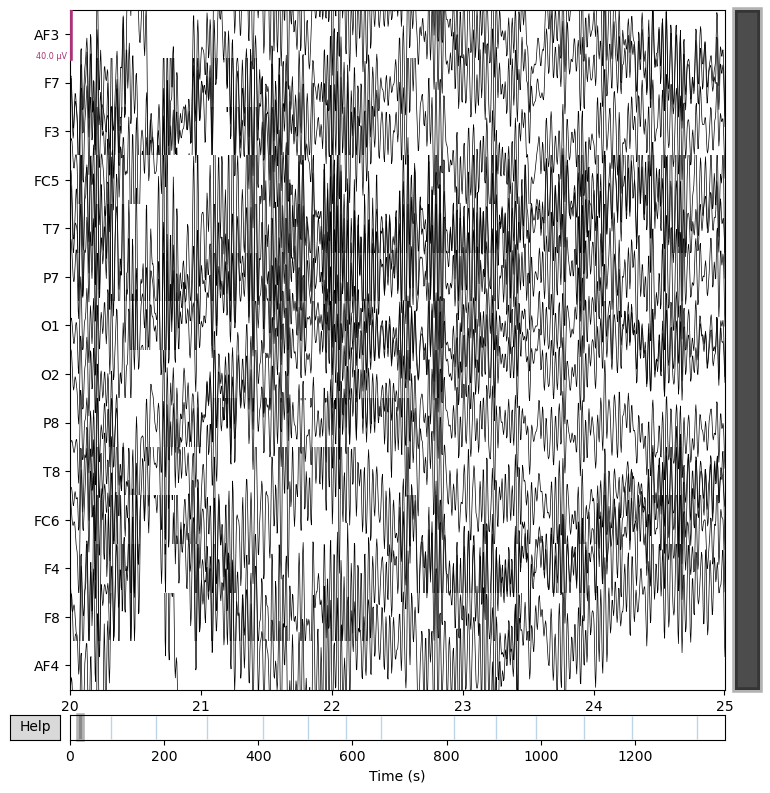

NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.000 (s)


C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\2497950007.py:3: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  raw3.plot_psd(fmax=50)
C:\Users\Emma Reyner Fuentes\anaconda3\lib\site-packages\mne\viz\utils.py:151: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


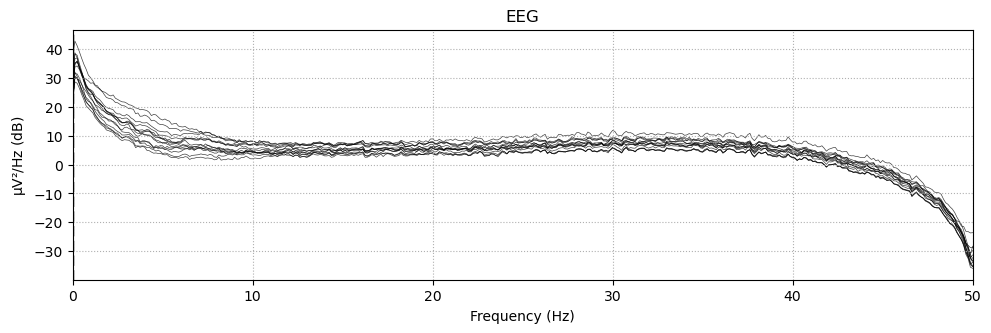

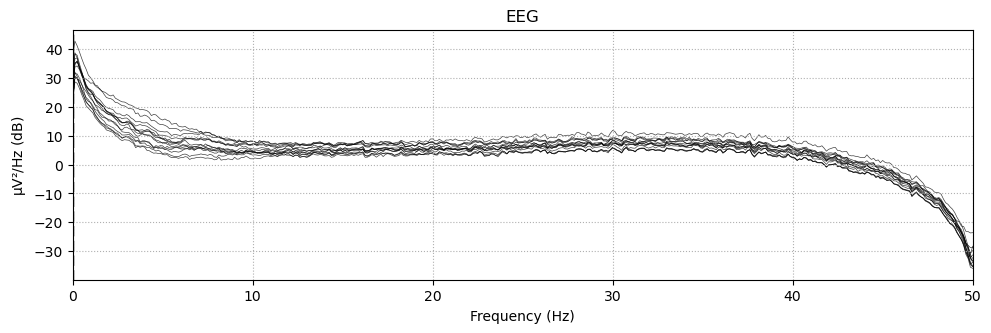

In [6]:
# Plotting the channels
raw3.plot(start=20, duration = 5, n_channels=14)
raw3.plot_psd(fmax=50)

## ADDING MONTAGE

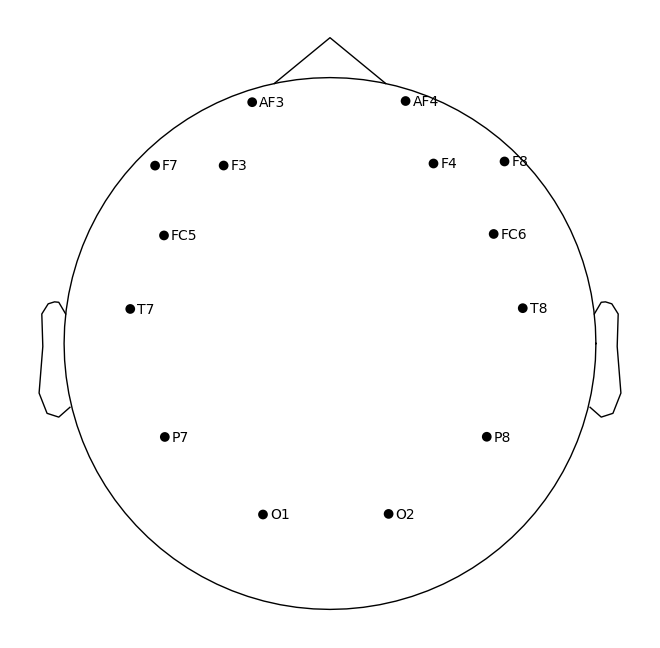

In [7]:
for raw in raws:
    raw.set_montage('standard_1020')

fig = raw5.plot_sensors(show_names=True)

## BANDPASS FILTER (4Hz-100Hz, a first general filtering)

In [8]:
# BANDPASS FILTER (4Hz-100Hz)
for i in range(0, len(raws)):
    globals()['raw_bpf%s' % int(i+1)] = raws[i].copy().filter(l_freq=4, h_freq=100)
    
raw_bpfs = [raw_bpf1, raw_bpf2, raw_bpf3, raw_bpf4, raw_bpf5, raw_bpf6, raw_bpf7, raw_bpf8, raw_bpf9, raw_bpf10,
            raw_bpf11, raw_bpf12, raw_bpf13, raw_bpf14, raw_bpf15, raw_bpf16, raw_bpf17, raw_bpf18, raw_bpf19, 
            raw_bpf20, raw_bpf21, raw_bpf22, raw_bpf23, raw_bpf24, raw_bpf25, raw_bpf26, raw_bpf27]

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.3s finished


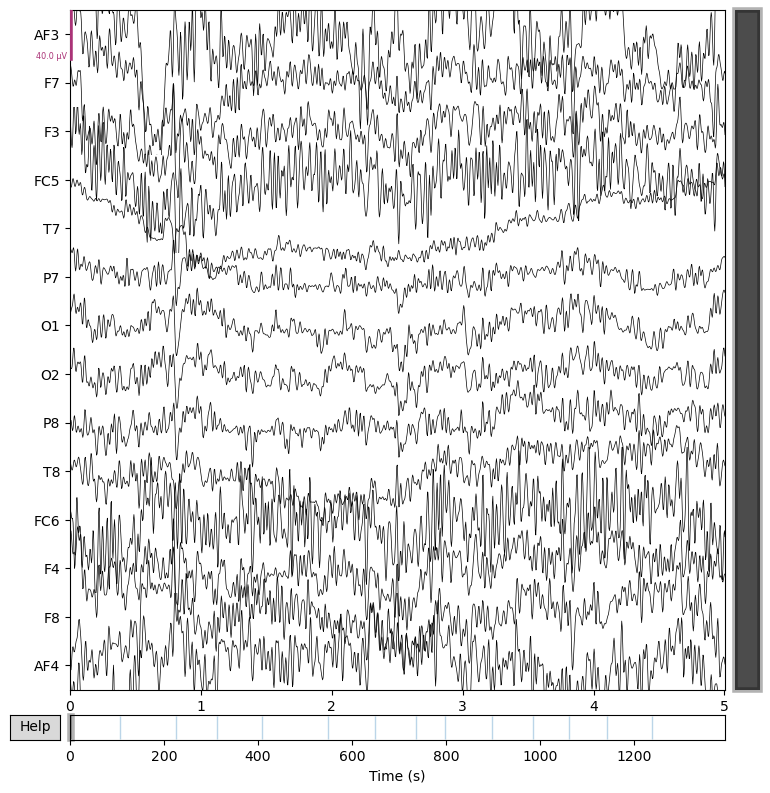

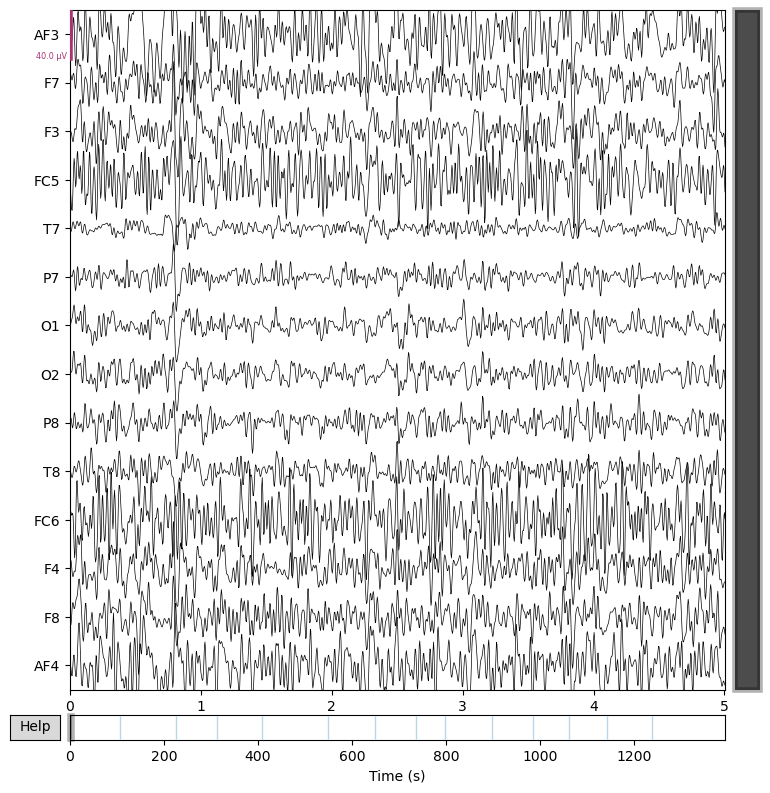

In [9]:
#See the result
fig = raw1.plot(duration=5)
fig2 = raw_bpf1.plot(duration=5)

## POWERLINE INTERFERENCE (notch filter 50Hz)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1691 samples (6.605 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.1s finished


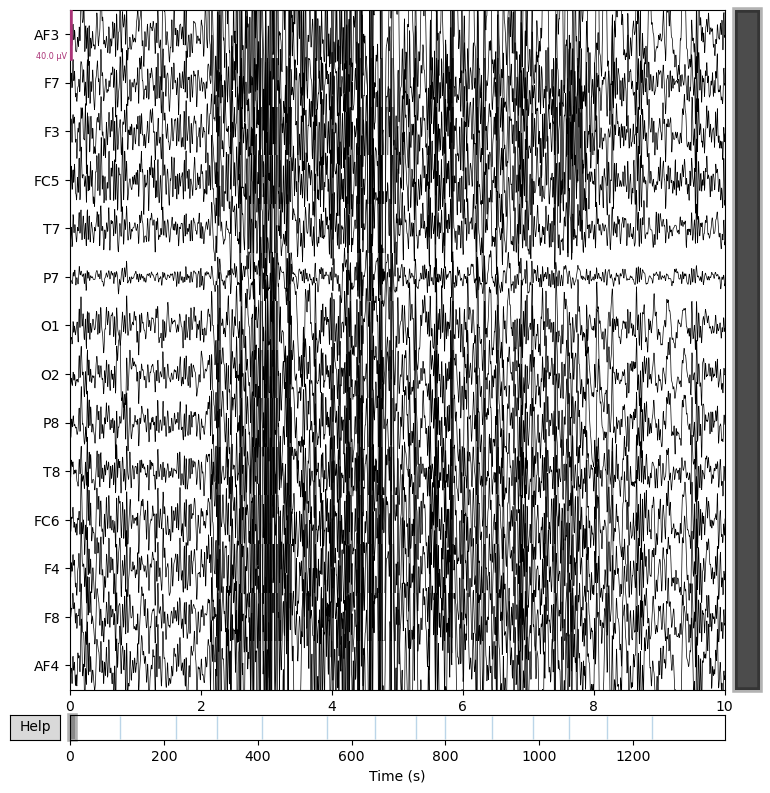

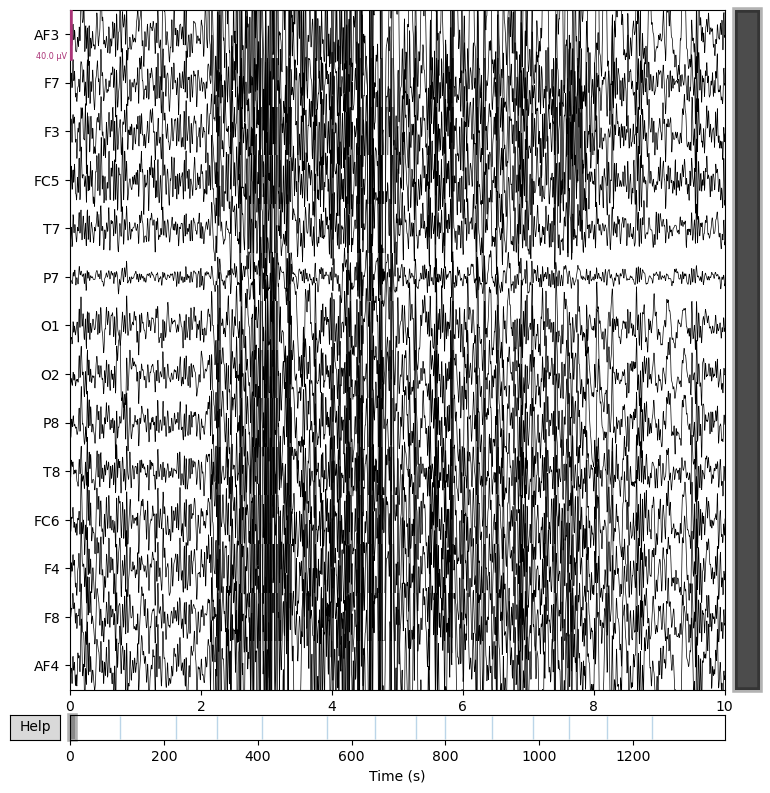

In [10]:
# POWERLINE INTERFERENCE (notch filter 50Hz)
for i in range(0, len(raws)):
    globals()['raw_notch%s' % int(i+1)] = raw_bpfs[i].copy().notch_filter(freqs = 50)

raw_notchs = [raw_notch1, raw_notch2, raw_notch3, raw_notch4, raw_notch5, raw_notch6, raw_notch7, raw_notch8, 
              raw_notch9, raw_notch10, raw_notch11, raw_notch12, raw_notch13, raw_notch14, raw_notch15, raw_notch16, 
              raw_notch17, raw_notch18, raw_notch19, raw_notch20, raw_notch21, raw_notch22, raw_notch23, raw_notch24, 
              raw_notch25, raw_notch26, raw_notch27]    
    

fig = raw_bpf10.plot()
fig2 = raw_notch10.plot()

## BANDPASS FILTER (4Hz-100Hz, keeping bands alpha, beta, theta and gamma)

In [11]:
# BANDPASS FILTER

for i in range(0, len(raws)):
    globals()['raw_bpf_2%s' % int(i+1)] = raw_notchs[i].copy().filter(l_freq=4, h_freq=100)
    
raw_bpf_2s = [raw_bpf_21, raw_bpf_22, raw_bpf_23, raw_bpf_24, raw_bpf_25, raw_bpf_26, raw_bpf_27, raw_bpf_28, 
              raw_bpf_29, raw_bpf_210, raw_bpf_211, raw_bpf_212, raw_bpf_213, raw_bpf_214, raw_bpf_215, raw_bpf_216, 
              raw_bpf_217, raw_bpf_218, raw_bpf_219, raw_bpf_220, raw_bpf_221, raw_bpf_222, raw_bpf_223, raw_bpf_224, 
              raw_bpf_225, raw_bpf_226, raw_bpf_227]

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 423 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    0.2s finished


In [12]:
#Ver el resultado del filtrado en frecuencia
fig = raw8.compute_psd(fmax=128, average='mean').plot()
fig2 = raw_bpf_28.compute_psd(fmax=128, average='mean').plot()

Effective window size : 8.000 (s)
Effective window size : 8.000 (s)


C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\1618099369.py:2: RuntimeWarning: in version 1.5, the default behavior of Spectrum.plot() will change so that bad channels will be shown by default. To keep the old default behavior (and silence this warning), explicitly pass `picks='data', exclude='bads'`.
  fig = raw8.compute_psd(fmax=128, average='mean').plot()
C:\Users\Emma Reyner Fuentes\anaconda3\lib\site-packages\mne\viz\utils.py:151: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\1618099369.py:3: RuntimeWarning: in version 1.5, the default behavior of Spectrum.plot() will change so that bad channels will be shown by default. To keep the old default behavior (and silence this warning), explicitly pass `picks='data', exclude='bads'`.
  fig2 = raw_bpf_28.compute_psd(fmax=128, average=

## ICA

In [13]:
for i in range(0, len(raws)):
    globals()['ica%s' % int(i+1)] = ICA(n_components = 14, random_state = 23)
    
icas = [ica1, ica2, ica3, ica4, ica5, ica6, ica7, ica8, ica9, ica10, 
        ica11, ica12, ica13, ica14, ica15, ica16, ica17, ica18, ica19, ica20,
        ica21, ica22, ica23, ica24, ica25, ica26, ica27]

for i in range(0, len(raws)):
    globals()['raw_ica%s' % int(i+1)] = icas[i].fit(raw_notchs[i])

ica5

Fitting ICA to data using 14 channels (please be patient, this may take a while)
Selecting by number: 14 components
Fitting ICA took 6.4s.
Fitting ICA to data using 14 channels (please be patient, this may take a while)
Selecting by number: 14 components
Fitting ICA took 9.1s.
Fitting ICA to data using 14 channels (please be patient, this may take a while)
Selecting by number: 14 components
Fitting ICA took 10.5s.
Fitting ICA to data using 14 channels (please be patient, this may take a while)
Selecting by number: 14 components
Fitting ICA took 10.0s.
Fitting ICA to data using 14 channels (please be patient, this may take a while)
Selecting by number: 14 components
Fitting ICA took 8.5s.
Fitting ICA to data using 14 channels (please be patient, this may take a while)
Selecting by number: 14 components
Fitting ICA took 10.5s.
Fitting ICA to data using 14 channels (please be patient, this may take a while)
Selecting by number: 14 components
Fitting ICA took 9.5s.
Fitting ICA to data usin

Method,fastica
Fit,37 iterations on raw data (350592 samples)
ICA components,14
Available PCA components,14
Channel types,eeg
ICA components marked for exclusion,—


    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
695 matching events found
No baseline correction applied
0 projection items activated


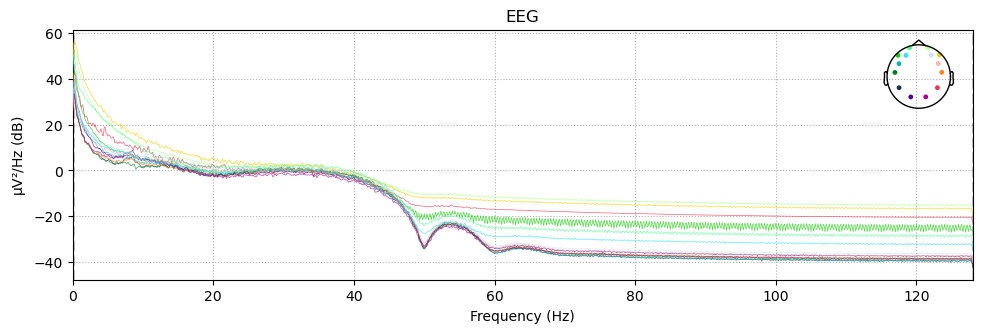

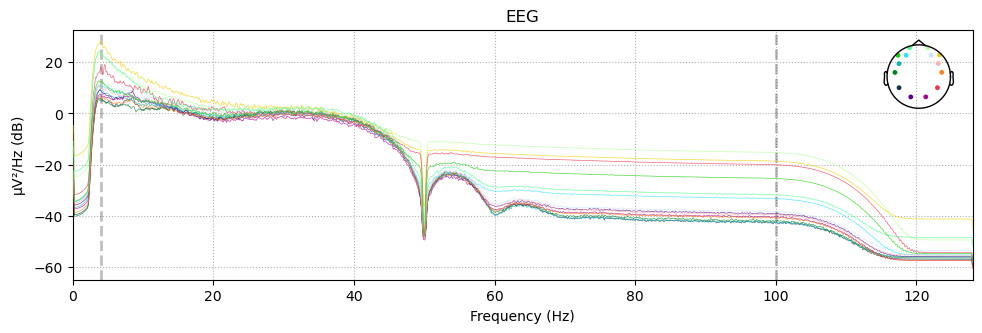

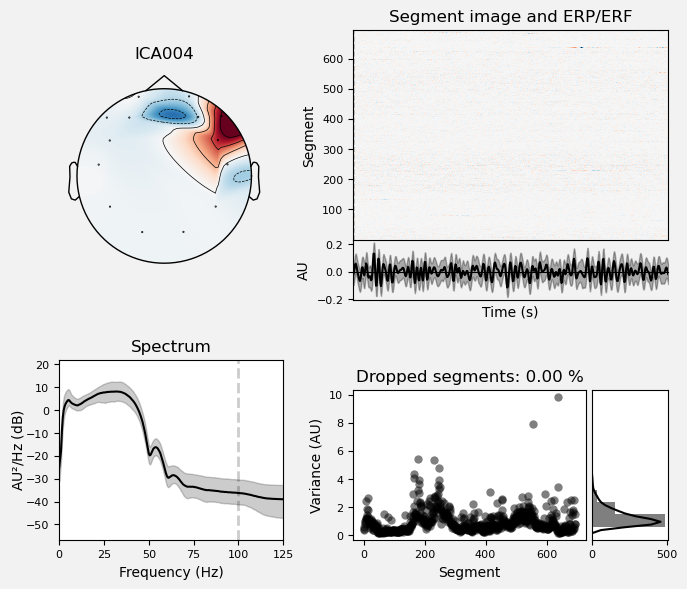

[<Figure size 700x600 with 6 Axes>]

In [14]:
#Seeing closely one channel
ica3.plot_properties(raw_bpf_2s[2], picks=4)

Creating RawArray with float64 data, n_channels=14, n_times=350592
    Range : 0 ... 350591 =      0.000 ...  1369.496 secs
Ready.


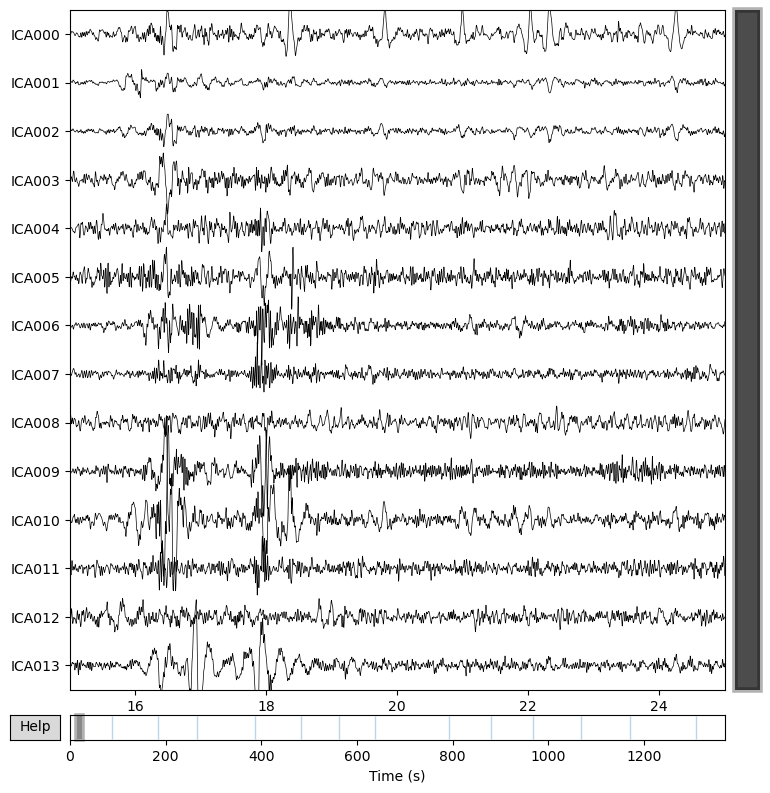

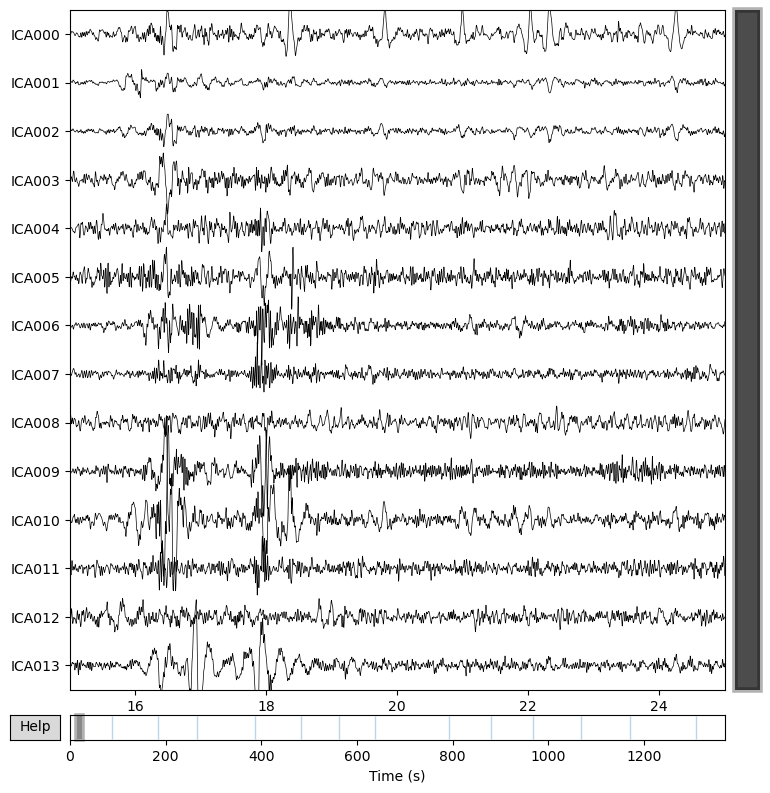

In [15]:
#Plotting the created components
ica5.plot_sources(raw_bpf_2s[4], start=15, stop=25)

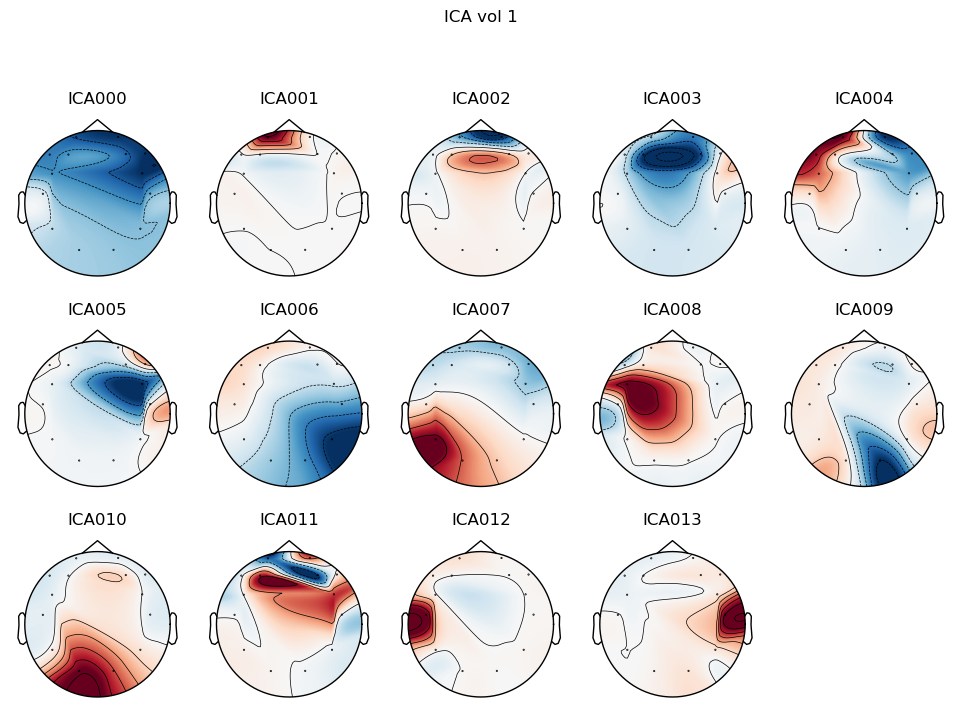

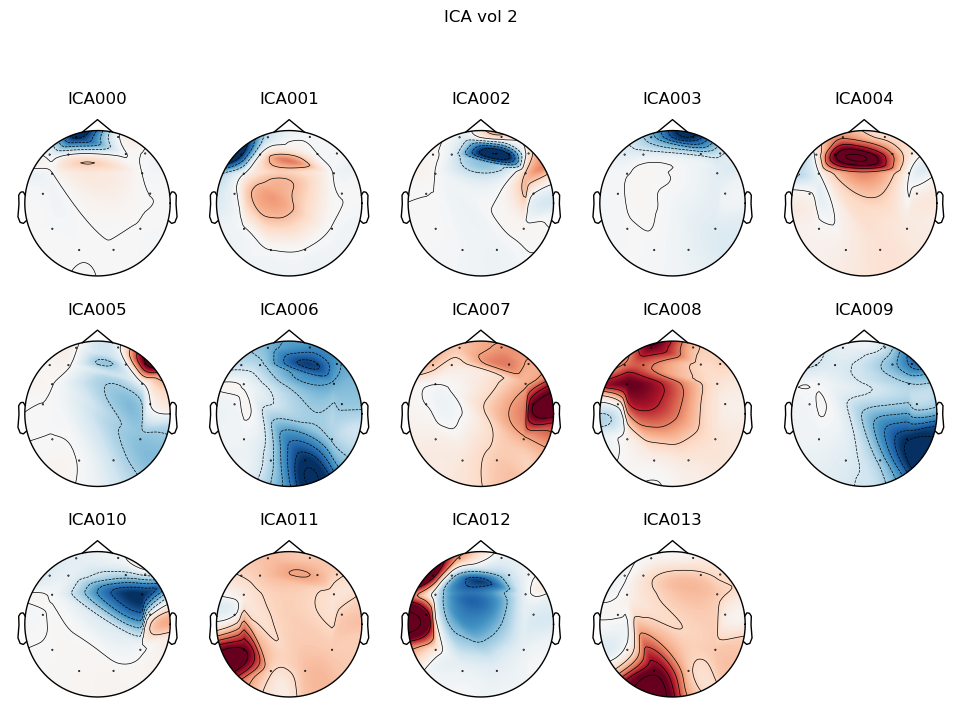

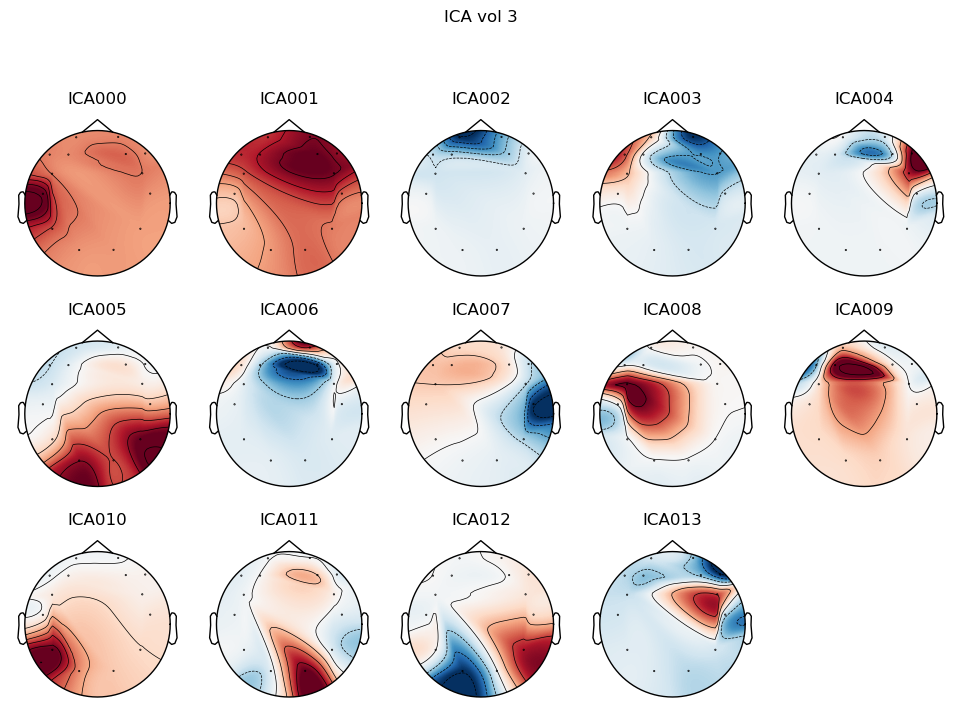

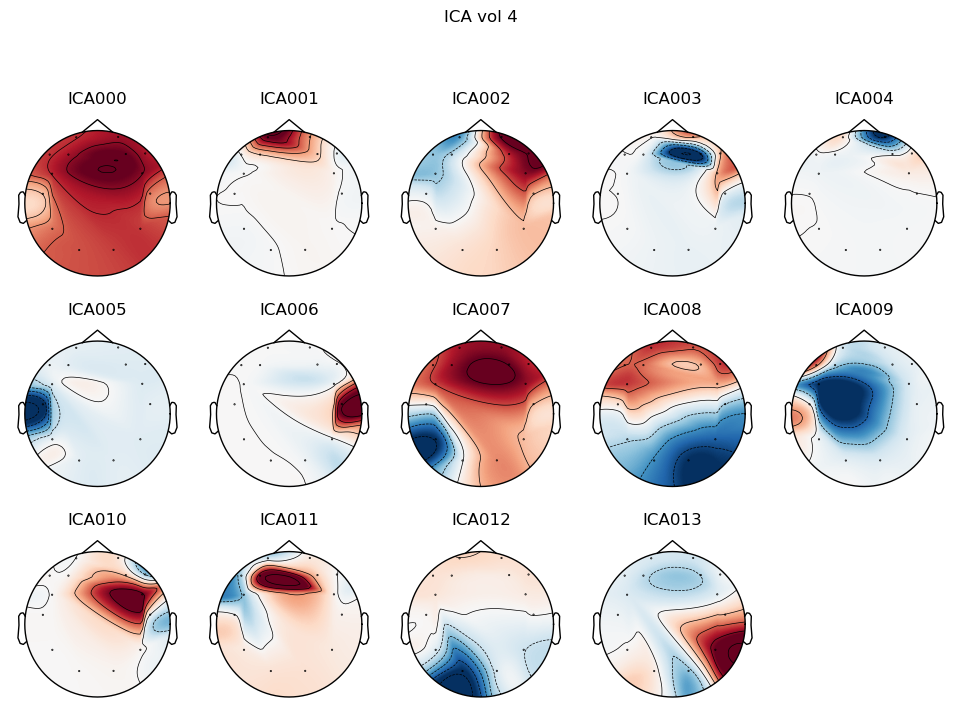

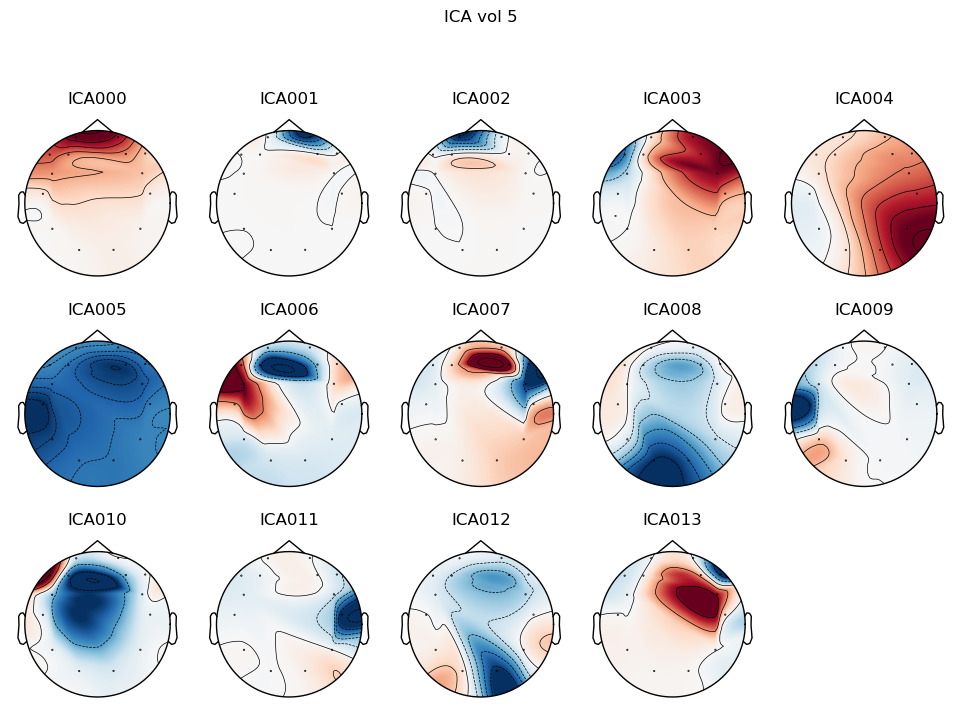

...

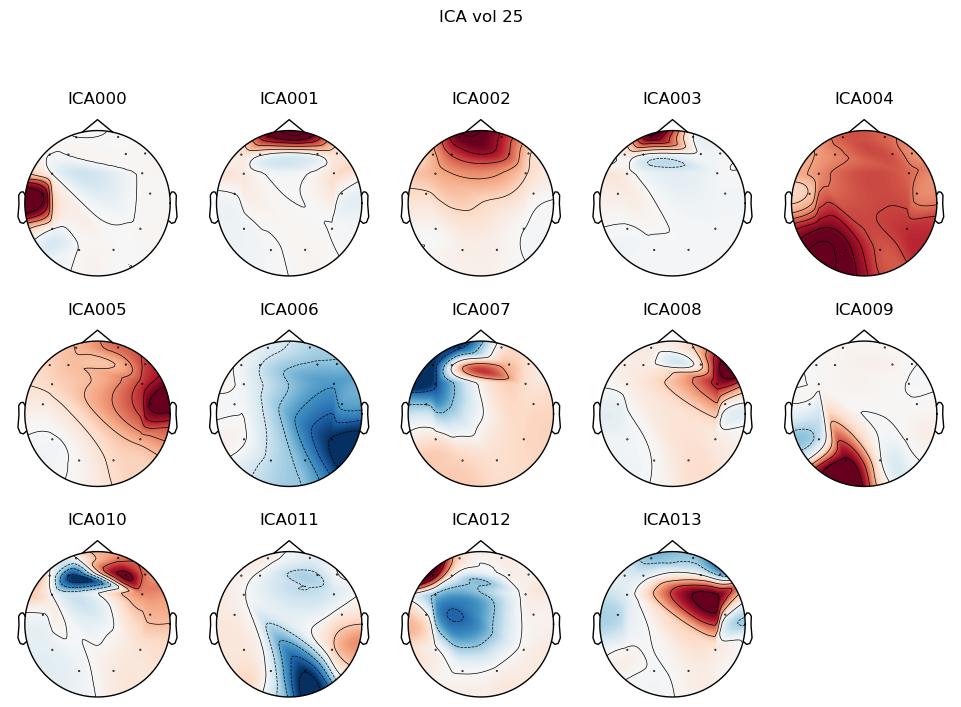

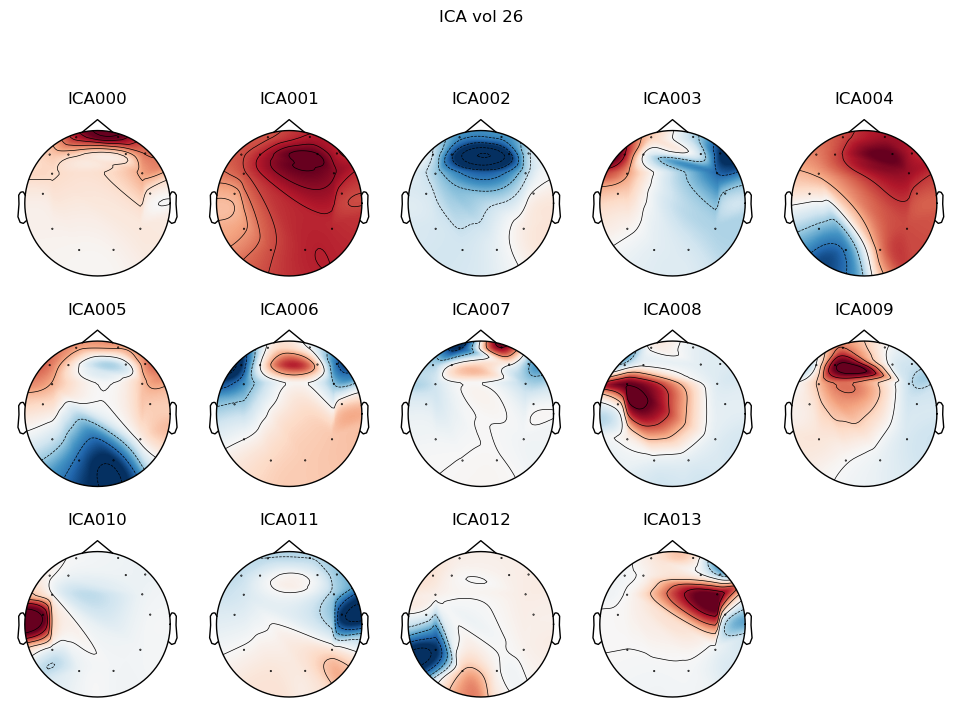

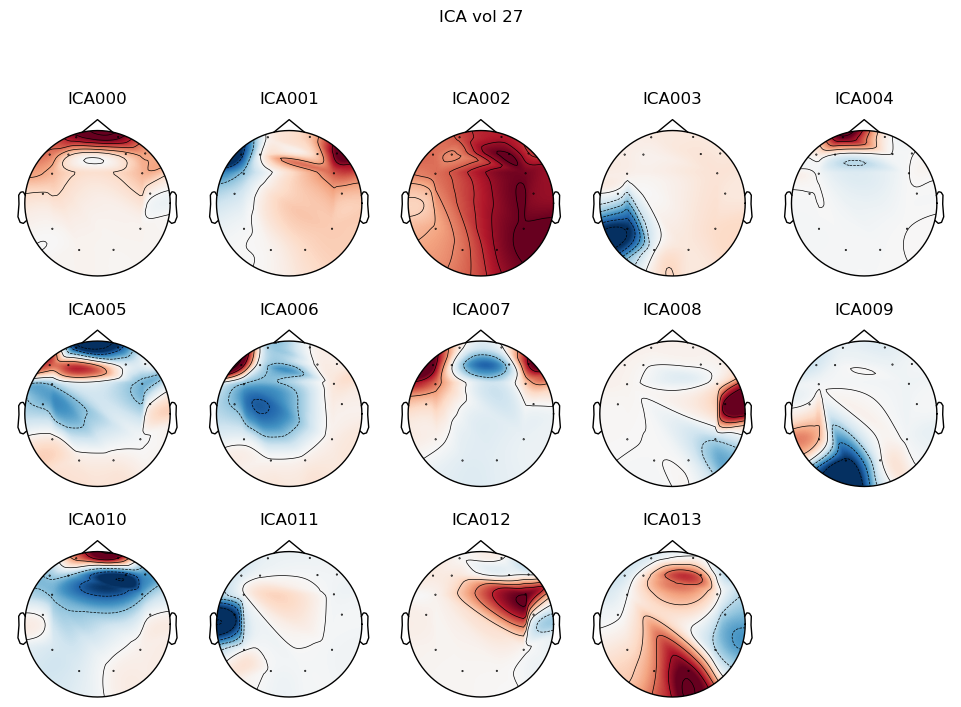

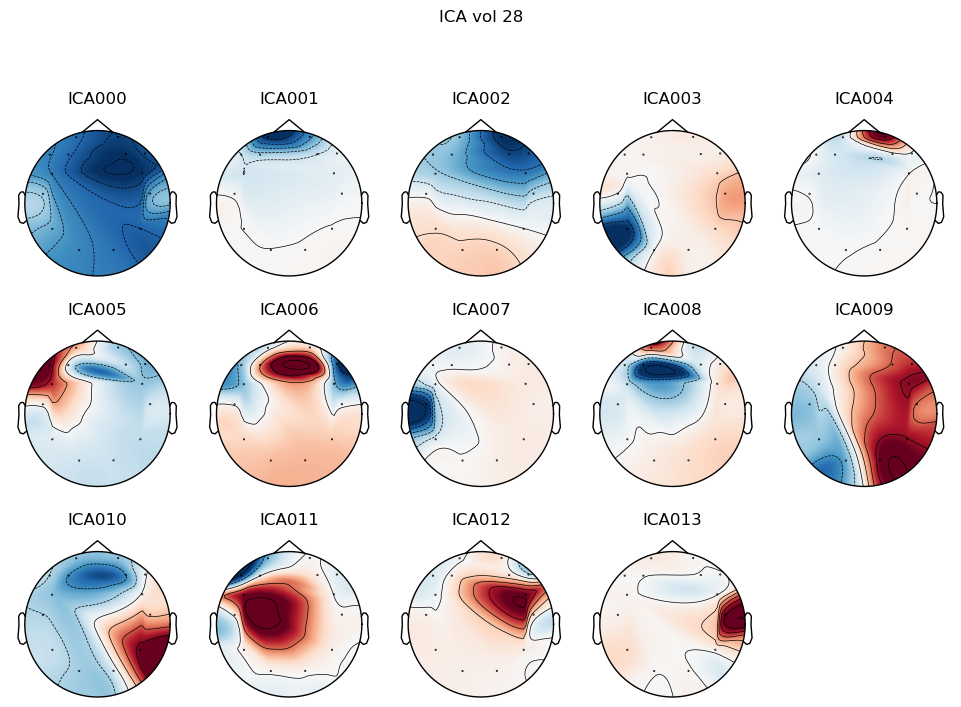

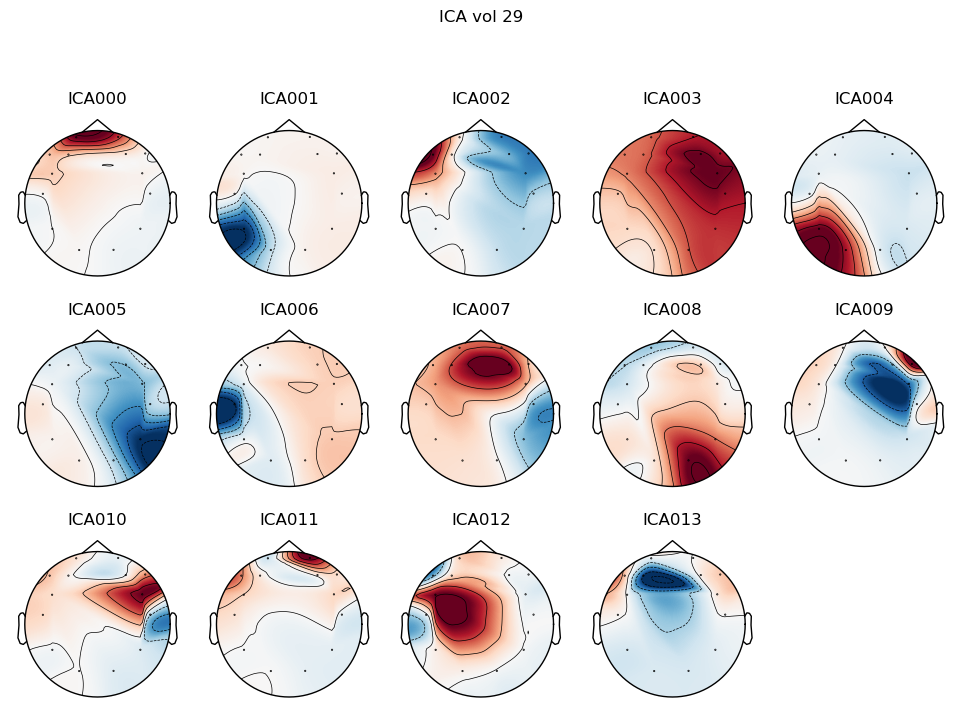

In [16]:
#Plotting them in space
#There is a need to go over each of the volunteers to visually identify the noise channels and remove them
a= 1
for ica in icas:
    if a == 6 or a == 11:
        a+=1
    ica.plot_components(title="ICA vol %s" % a)
    a+=1

In [17]:
# Reconstruct without the chosen channels
#1 - not clear
#ica1.exclude = [0, 4]
raw_postica1 = raw_bpf_2s[0].copy()
ica1.apply(raw_postica1)

#2 - channel 0, maybe 2 or 3
ica2.exclude = [0]
raw_postica2 = raw_bpf_2s[1].copy()
ica2.apply(raw_postica2)

#3 - channel 2
ica3.exclude = [2]
raw_postica3 = raw_bpf_2s[2].copy()
ica3.apply(raw_postica3)

#4 - channel 1
ica4.exclude = [1]
raw_postica4 = raw_bpf_2s[3].copy()
ica4.apply(raw_postica4)

#5 - channels 0, 1 and 2
ica5.exclude = [0, 1, 2]
raw_postica5 = raw_bpf_2s[4].copy()
ica5.apply(raw_postica5)


#7 - channels 0 and 6
ica6.exclude = [0, 6]
raw_postica6 = raw_bpf_2s[5].copy()
ica6.apply(raw_postica6)

#8 - channel 0
ica7.exclude = [0]
raw_postica7 = raw_bpf_2s[6].copy()
ica7.apply(raw_postica7)

#9 - channels 1 and 2
ica8.exclude = [1, 2]
raw_postica8 = raw_bpf_2s[7].copy()
ica8.apply(raw_postica8)

#10 - channel 1
ica9.exclude = [1]
raw_postica9 = raw_bpf_2s[8].copy()
ica9.apply(raw_postica9)

#12 - channel 1
ica10.exclude = [1]
raw_postica10 = raw_bpf_2s[9].copy()
ica10.apply(raw_postica10)

#13 - channel 3
ica11.exclude = [3]
raw_postica11 = raw_bpf_2s[10].copy()
ica11.apply(raw_postica11)

#14 - channels 1 and 2
ica12.exclude = [1, 2]
raw_postica12 = raw_bpf_2s[11].copy()
ica12.apply(raw_postica12)

#15 - channel 1
ica13.exclude = [1]
raw_postica13 = raw_bpf_2s[12].copy()
ica13.apply(raw_postica13)

#16 - channel 0
ica14.exclude = [0]
raw_postica14 = raw_bpf_2s[13].copy()
ica14.apply(raw_postica14)

#17 - channel 1
ica15.exclude = [1]
raw_postica15 = raw_bpf_2s[14].copy()
ica15.apply(raw_postica15)

#18 - channel 0 EOG and in 2 a weird periodic noise
ica16.exclude = [0,2]
raw_postica16 = raw_bpf_2s[15].copy()
ica16.apply(raw_postica16)

#19 - channel 1
ica17.exclude = [1]
raw_postica17 = raw_bpf_2s[16].copy()
ica17.apply(raw_postica17)

#20 - channel 1
ica18.exclude = [1]
raw_postica18 = raw_bpf_2s[17].copy()
ica18.apply(raw_postica18)

#21 - Not clear
#ica19.exclude = [3, 2]
raw_postica19 = raw_bpf_2s[18].copy()
ica19.apply(raw_postica19)

#22 - channel 0
ica20.exclude = [0]
raw_postica20 = raw_bpf_2s[19].copy()
ica20.apply(raw_postica20)

#23 - channel 2
ica21.exclude = [2]
raw_postica21 = raw_bpf_2s[20].copy()
ica21.apply(raw_postica21)

#24 - channels 0 and 1
ica22.exclude = [0, 1]
raw_postica22 = raw_bpf_2s[21].copy()
ica22.apply(raw_postica22)

#25 - channels 1 ECG and 8 periodic weird noise
ica23.exclude = [1, 8]
raw_postica23 = raw_bpf_2s[22].copy()
ica23.apply(raw_postica23)

#26 - channel 0
ica24.exclude = [0]
raw_postica24 = raw_bpf_2s[23].copy()
ica24.apply(raw_postica24)

#27 - channel 0
ica25.exclude = [0]
raw_postica25 = raw_bpf_2s[24].copy()
ica25.apply(raw_postica25)

#28 - channel 1
ica26.exclude = [1]
raw_postica26 = raw_bpf_2s[25].copy()
ica26.apply(raw_postica26)

#29 - channel 0
ica27.exclude = [0]
raw_postica27 = raw_bpf_2s[26].copy()
ica27.apply(raw_postica27)

Applying ICA to Raw instance
    Transforming to ICA space (14 components)
    Zeroing out 0 ICA components
    Projecting back using 14 PCA components
Applying ICA to Raw instance
    Transforming to ICA space (14 components)
    Zeroing out 1 ICA component
    Projecting back using 14 PCA components
Applying ICA to Raw instance
    Transforming to ICA space (14 components)
    Zeroing out 1 ICA component
    Projecting back using 14 PCA components
Applying ICA to Raw instance
    Transforming to ICA space (14 components)
    Zeroing out 1 ICA component
    Projecting back using 14 PCA components
Applying ICA to Raw instance
    Transforming to ICA space (14 components)
    Zeroing out 3 ICA components
    Projecting back using 14 PCA components
Applying ICA to Raw instance
    Transforming to ICA space (14 components)
    Zeroing out 2 ICA components
    Projecting back using 14 PCA components
Applying ICA to Raw instance
    Transforming to ICA space (14 components)
    Zeroing out 

<RawBrainVision | sub-S29G_ses-P1_task-T1_eeg.eeg, 14 x 357248 (1395.5 s), ~38.2 MB, data loaded>

In [18]:
raw_posticas = [raw_postica1, raw_postica2, raw_postica3, raw_postica4, raw_postica5, raw_postica6, raw_postica7,
                raw_postica8, raw_postica9, raw_postica10, raw_postica11, raw_postica12, raw_postica13, raw_postica14,
                raw_postica15, raw_postica16, raw_postica17, raw_postica18, raw_postica19, raw_postica20, raw_postica21,
                raw_postica22, raw_postica23, raw_postica24, raw_postica25, raw_postica26, raw_postica27]

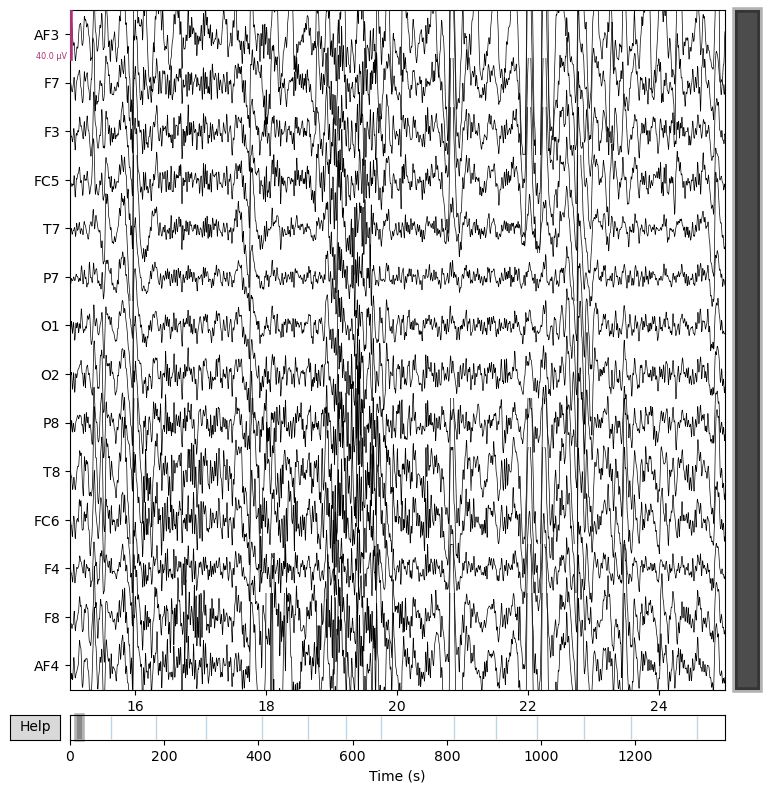

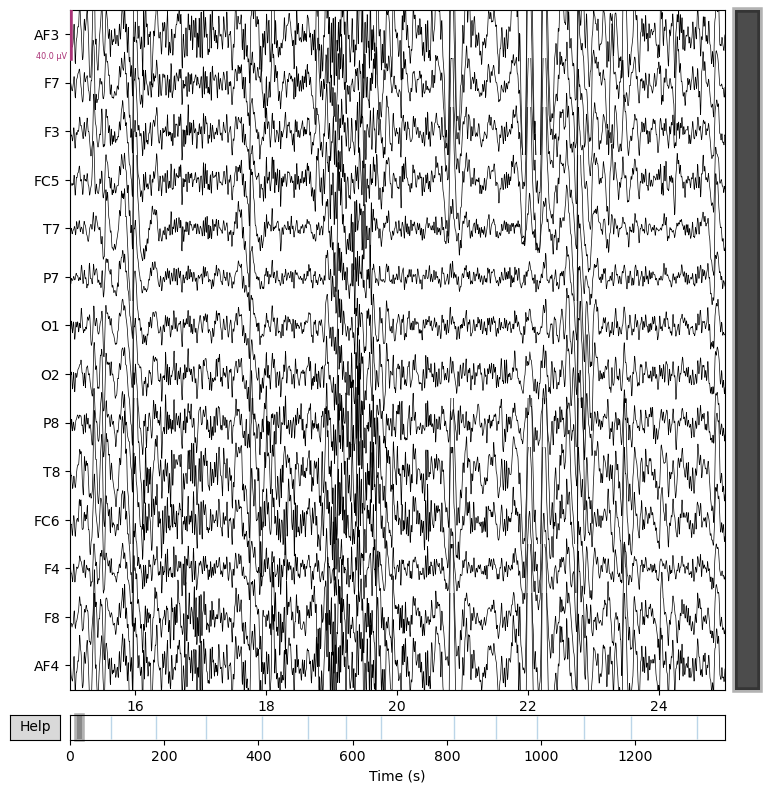

In [19]:
fig = raw_notchs[5].plot(start=15)
fig1 = raw_postica6.plot(start=15)

fig.set_size_inches(8, 15)
fig1.set_size_inches(8, 15)

## EVENTS (using the annotations to separate videos)

Used Annotations descriptions: ['Stimulus/S  1']
Used Annotations descriptions: ['Stimulus/S  1']
Used Annotations descriptions: ['Stimulus/S  1']
Used Annotations descriptions: ['Stimulus/S  1']
Used Annotations descriptions: ['Stimulus/S  1']
Used Annotations descriptions: ['Stimulus/S  1']
Used Annotations descriptions: ['Stimulus/S  1']
Used Annotations descriptions: ['Stimulus/S  1']
Used Annotations descriptions: ['Stimulus/S  1']
Used Annotations descriptions: ['Stimulus/S  1']
Used Annotations descriptions: ['Stimulus/S  1']
Used Annotations descriptions: ['Stimulus/S  1']
Used Annotations descriptions: ['Stimulus/S  1']
Used Annotations descriptions: ['Stimulus/S  1']
Used Annotations descriptions: ['Stimulus/S  1']
Used Annotations descriptions: ['Stimulus/S  1']
Used Annotations descriptions: ['Stimulus/S  1']
Used Annotations descriptions: ['Stimulus/S  1']
Used Annotations descriptions: ['Stimulus/S  1']
Used Annotations descriptions: ['Stimulus/S  1']
Used Annotations des

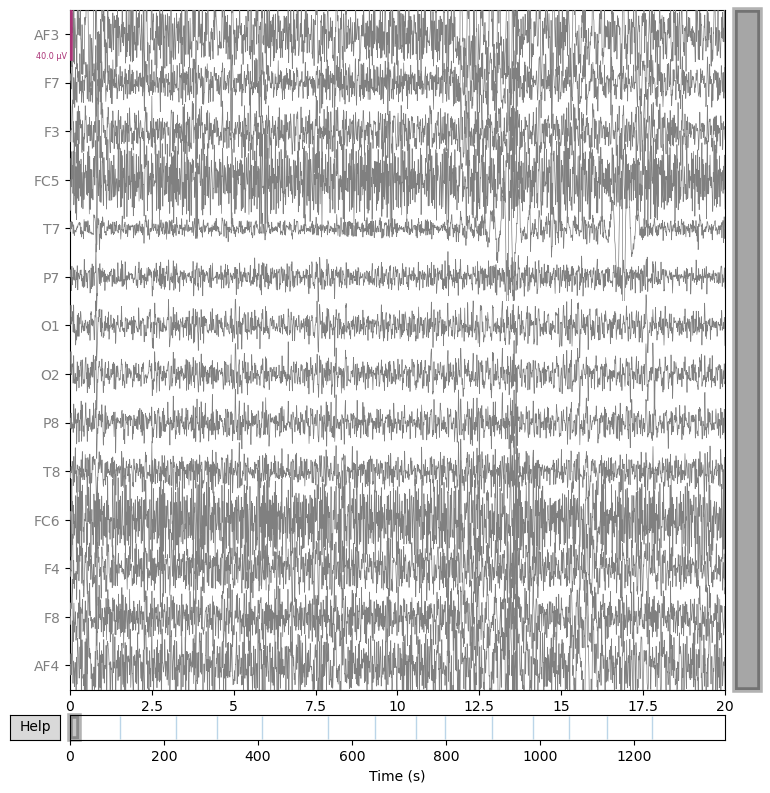

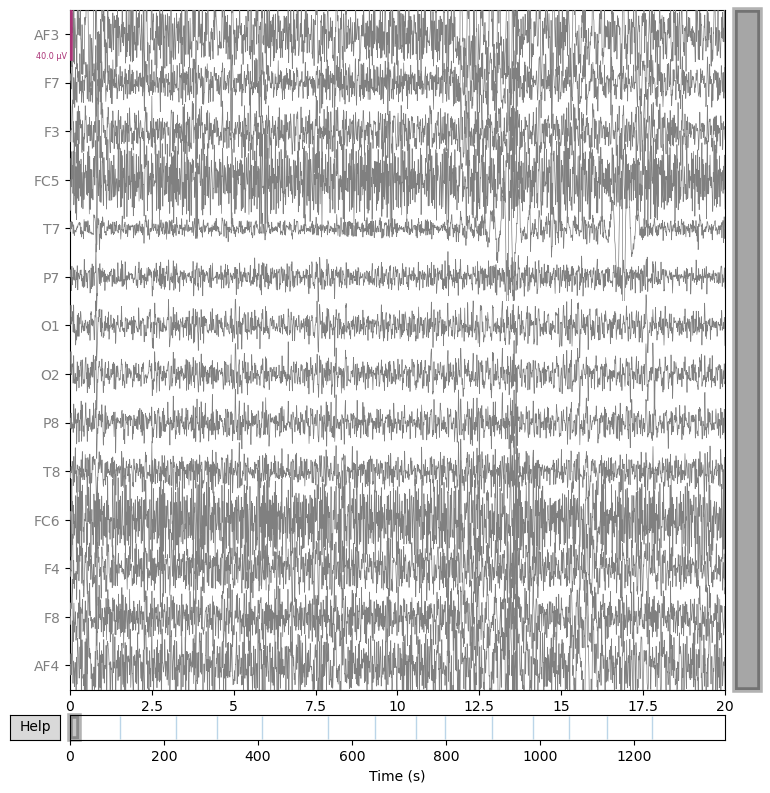

In [20]:
# Plot the events
for i in range(0, len(raws)):
    globals()['event%s' % int(i+1)] = mne.events_from_annotations(raws[i])
    
events = [event1, event2, event3, event4, event5, event6, event7, event8, event9, event10, event11, 
          event12, event13, event14, event15, event16, event17, event18, event19, event20, event21, 
          event22, event23, event24, event25, event26, event27]

print(event1)
raw_postica1.plot(duration=20, events=events[0][0], color='gray', event_color={1:'r'})

In [21]:
# Array with the times of the events
for i in range(0, len(raws)):
    globals()['time%s' % int(i+1)] = events[i][0]
    
times = [time1, time2, time3, time4, time5, time6, time7, time8, time9, time10, time11, 
        time12, time13, time14, time15, time16, time17, time18, time19, time20, time21, 
        time22, time23, time24, time25, time26, time27]

In [22]:
for time in times:
    for i in range(0, len(time)):
        time[i][0] = int(time[i][0]/256)

# Choose a volunteer

In [23]:
# From now on it is more efficient to choose a volunteer to conduct the rest of the treatment rather than doing them all together


#Choose volunteer number:

vol = 29


vol_elegida = vol
if vol >=6:
    vol_df = vol-1
    vol = vol-2    
else: 
    vol_df = vol-1
    vol = vol-1
a=0
if vol >=10:
    vol = vol-1


print("vol_elegida: ", vol_elegida)
print("vol_df: ", vol_df)
print("vol: ", vol)
time = times[vol]
raw_postica = raw_posticas[vol]

vol_elegida:  29
vol_df:  28
vol:  26


In [24]:
# Crop the videos:
if vol_elegida == 23:
    video1 = raw_postica.copy().crop(tmax=time[0][0])
    for i in range(1, len(time)):
        globals()['video%s' % int(i+1)] = raw_postica.copy().crop(tmin=time[i-1][0], tmax=time[i][0])
    video12 = raw_postica.copy().crop(tmin=time[len(time)-1][0])
    
    videos = [video1, video2, video3, video4, video5, video6, video7, video8, video9, video10, video11, video12]
    
else: 
    video1 = raw_postica.copy().crop(tmax=time[0][0])
    for i in range(1, len(time)):
        globals()['video%s' % int(i+1)] = raw_postica.copy().crop(tmin=time[i-1][0], tmax=time[i][0])
    video14 = raw_postica.copy().crop(tmin=time[len(time)-1][0])

    videos = [video1, video2, video3, video4, video5, video6, video7, video8, video9, video10, video11, video12, video13, 
              video14]

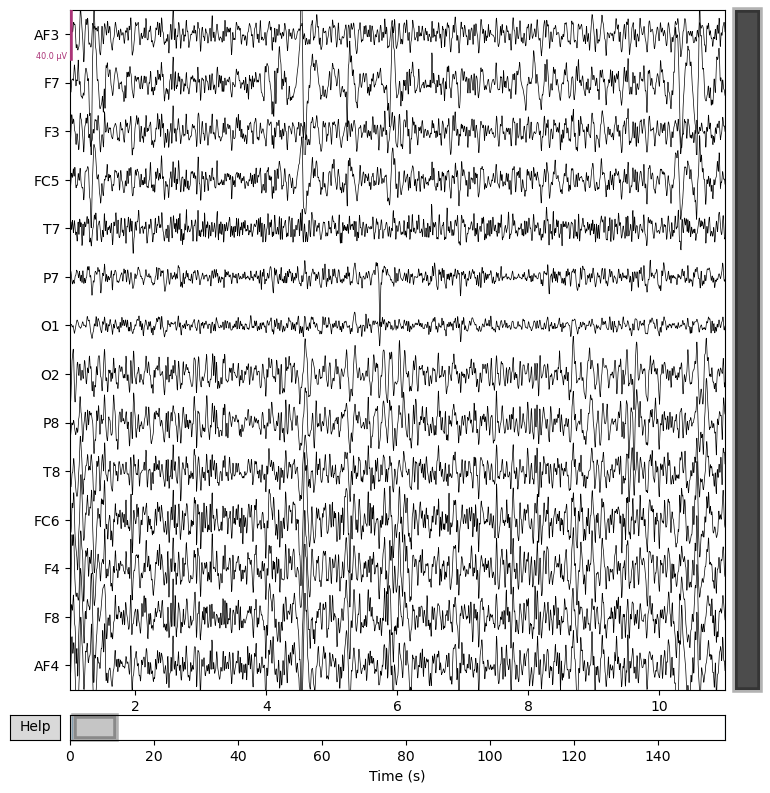

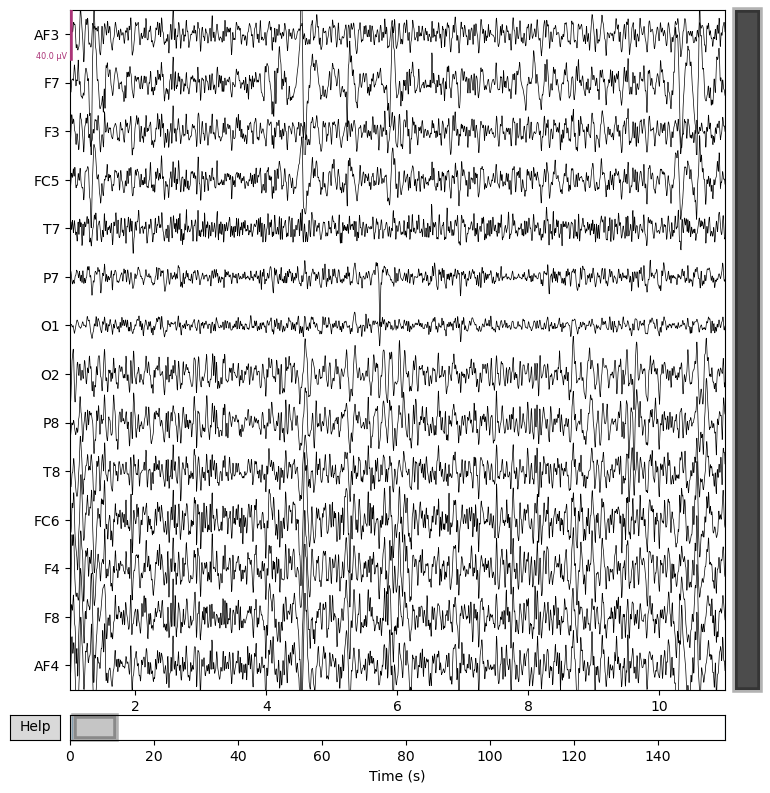

In [25]:
video10.plot(start=1)

## MEAN + STD PER VIDEO PER VOL

In [26]:
df_mean_std = pd.DataFrame(columns = ['Voluntaria', 'Video', 'Canal', 'Media', 'STD'], index = range(0, 14*14))
df_mean_std['Voluntaria'] = df_vols['Voluntaria'].iloc[vol_df]

for i in range(0, len(videos)):
    df_mean_std['Video'][(i+13*i):i+13*i+14] = df_vols[df_vols.columns[i+1]].iloc[vol_df]
    
    v, t = videos[i][:]
    v = np.stack(v, axis=0)
    for j in range(0, 14):
        df_mean_std['Canal'][(i+13*i)+j] = j
        df_mean_std['Media'][(i+13*i)+j] = sts.mean(v[j, :])
        df_mean_std['STD'][(i+13*i)+j] = sts.stdev(v[j, :])
    
df_mean_std.head()

,Voluntaria,Video,Canal,Media,STD
0,S029G,Video2,0,-0.0,0.000009
1,S029G,Video2,1,-0.0,0.000014
2,S029G,Video2,2,-0.0,0.000008
3,S029G,Video2,3,-0.0,0.000009
4,S029G,Video2,4,0.0,0.000016


In [27]:
# Write in CSV
#path = 'Mean+STD/' + df_vols['Voluntaria'].iloc[vol_df] + "_mean_std"
#df_mean_std.to_csv(pathlib.Path(path))

### Create annotations to remove the spans where the amplitude is over mean+5*std 

In [28]:
for i in range(0, len(videos)):
    globals()['data_video%s' % int(i+1)] = videos[i].get_data()

if vol_elegida == 23:
    data_videos = [data_video1, data_video2, data_video3, data_video4, data_video5, data_video6, data_video7, data_video8,
                  data_video9, data_video10, data_video11, data_video12]
else:   
    data_videos = [data_video1, data_video2, data_video3, data_video4, data_video5, data_video6, data_video7, data_video8,
                  data_video9, data_video10, data_video11, data_video12, data_video13, data_video14]

In [29]:
for i in range(0, len(videos)):
    globals()['ruido_video%s' % int(i+1)] = pd.DataFrame(columns= ['canal', 'indice'])
if vol_elegida == 23:
    ruidos = [ruido_video1, ruido_video2, ruido_video3, ruido_video4, ruido_video5, ruido_video6, ruido_video7, 
             ruido_video8, ruido_video9, ruido_video10, ruido_video11, ruido_video12]
else:
    ruidos = [ruido_video1, ruido_video2, ruido_video3, ruido_video4, ruido_video5, ruido_video6, ruido_video7, 
             ruido_video8, ruido_video9, ruido_video10, ruido_video11, ruido_video12, ruido_video13, ruido_video14]

for vid in range(0, len(data_videos)):
    #print('vid: ' + str(vid+1))
    for ch in range(0, 14):
        #print('ch: ' + str(ch))
        m = df_mean_std['Media'][ch+(vid*14)]
        #print('m: '+ str(m))
        std = df_mean_std['STD'][ch+(vid*14)]
        #print('std: '+ str(std))
        thr_1 = m + 5*abs(std)
        thr_2 = m - 5*abs(std)
        
        for i in range(0, np.shape(data_videos[vid])[1]):
            if data_videos[vid][ch][i] > thr_1 or data_videos[vid][ch][i] < thr_2:
                ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)

    

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ruidos[vid] = ruidos[vid].append({'canal' : ch, 'indice': i/256}, ignore_index = True)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\4183215738.py:23: Future

In [30]:
for vid in range(0, len(videos)):
    my_annot = mne.Annotations(onset=ruidos[vid]['indice']-0.2,  # in seconds
                           duration=0.5,  # in seconds, too
                           description='BAD')
    print(my_annot)
    globals()['video%s' % int(vid+1) + '_cut'] = videos[vid].copy().set_annotations(my_annot)


C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\2291790651.py:6: RuntimeWarning: Limited 8 annotation(s) that were expanding outside the data range.
  globals()['video%s' % int(vid+1) + '_cut'] = videos[vid].copy().set_annotations(my_annot)


<Annotations | 475 segments: BAD (475)>
<Annotations | 1351 segments: BAD (1351)>
<Annotations | 1045 segments: BAD (1045)>
<Annotations | 495 segments: BAD (495)>
<Annotations | 671 segments: BAD (671)>
<Annotations | 335 segments: BAD (335)>
<Annotations | 327 segments: BAD (327)>
<Annotations | 120 segments: BAD (120)>
<Annotations | 250 segments: BAD (250)>
<Annotations | 884 segments: BAD (884)>
<Annotations | 331 segments: BAD (331)>


C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\2291790651.py:6: RuntimeWarning: Limited 6 annotation(s) that were expanding outside the data range.
  globals()['video%s' % int(vid+1) + '_cut'] = videos[vid].copy().set_annotations(my_annot)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\2291790651.py:6: RuntimeWarning: Limited 14 annotation(s) that were expanding outside the data range.
  globals()['video%s' % int(vid+1) + '_cut'] = videos[vid].copy().set_annotations(my_annot)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\2291790651.py:6: RuntimeWarning: Limited 32 annotation(s) that were expanding outside the data range.
  globals()['video%s' % int(vid+1) + '_cut'] = videos[vid].copy().set_annotations(my_annot)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\2291790651.py:6: RuntimeWarning: Limited 5 annotation(s) that were expanding outside the data range.
  globals()['video%s' % int(vid+1) + '_cut'] = videos[vid].cop

<Annotations | 640 segments: BAD (640)>
<Annotations | 273 segments: BAD (273)>
<Annotations | 1021 segments: BAD (1021)>


C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\2291790651.py:6: RuntimeWarning: Limited 6 annotation(s) that were expanding outside the data range.
  globals()['video%s' % int(vid+1) + '_cut'] = videos[vid].copy().set_annotations(my_annot)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\2291790651.py:6: RuntimeWarning: Limited 17 annotation(s) that were expanding outside the data range.
  globals()['video%s' % int(vid+1) + '_cut'] = videos[vid].copy().set_annotations(my_annot)
C:\Users\Emma Reyner Fuentes\AppData\Local\Temp\ipykernel_28664\2291790651.py:6: RuntimeWarning: Limited 3 annotation(s) that were expanding outside the data range.
  globals()['video%s' % int(vid+1) + '_cut'] = videos[vid].copy().set_annotations(my_annot)


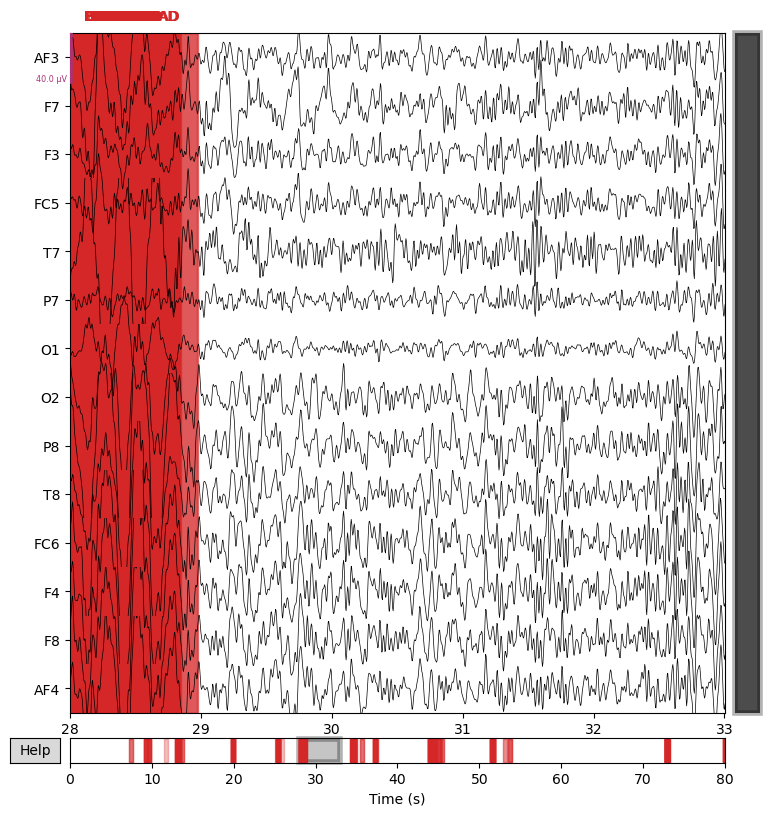

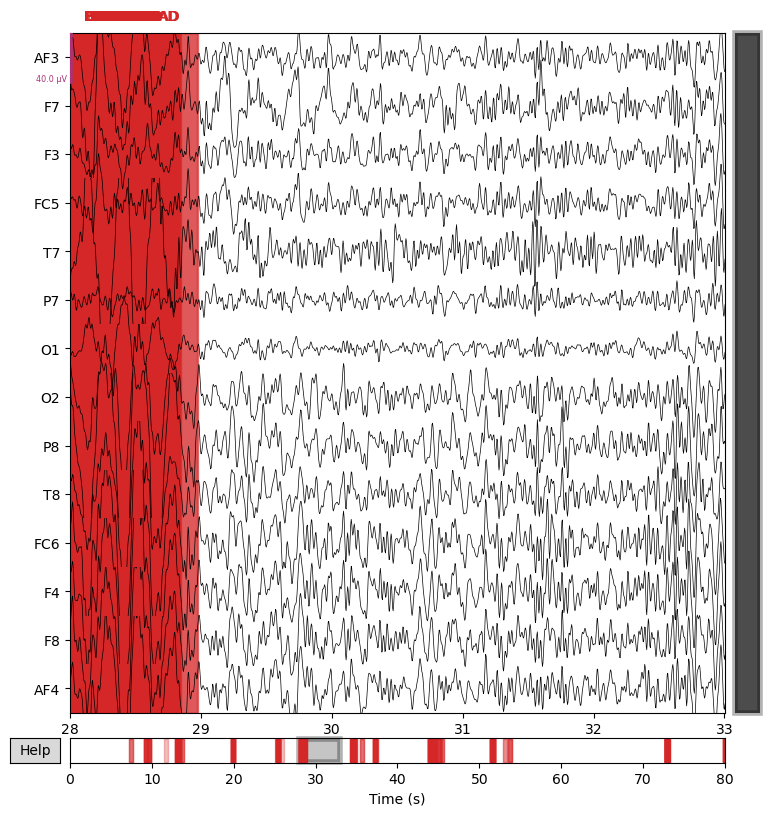

In [31]:
video1_cut.plot(start = 28, duration=5, color='black')

In [32]:
if vol_elegida == 23:
    videos_cut = [video1_cut, video2_cut, video3_cut, video4_cut, video5_cut, video6_cut, video7_cut, video8_cut,
                  video9_cut, video10_cut, video11_cut, video12_cut]
else:
    videos_cut = [video1_cut, video2_cut, video3_cut, video4_cut, video5_cut, video6_cut, video7_cut, video8_cut,
                  video9_cut, video10_cut, video11_cut, video12_cut, video13_cut, video14_cut]

### Creating 4 s EPOCHS

In [33]:
a = 1
for vid in videos_cut:
    onesec_events = mne.make_fixed_length_events(vid, id=1, duration=4)
    globals()['epoch_video%s' % int(a) + '_cut'] = mne.Epochs(vid, events=onesec_events, tmin = 0, tmax=4, baseline=(0, 0),
                                                    reject_by_annotation=True)
    a+=1
    

Not setting metadata
20 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Not setting metadata
34 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Not setting metadata
22 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Not setting metadata
25 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Not setting metadata
30 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Not setting metadata
21 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Not setting metadata
25 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Not setting metadata
22 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Not setting metadata
15 matching events found
Applying baseline 

In [34]:
epoch_video11_cut

Number of events,24
Events,1: 24
Time range,0.000 – 4.000 s
Baseline,0.000 – 0.000 s


In [35]:
if vol_elegida == 23:
    epoch_videos_cut = [epoch_video1_cut, epoch_video2_cut, epoch_video3_cut, epoch_video4_cut, epoch_video5_cut, 
                        epoch_video6_cut, epoch_video7_cut, epoch_video8_cut, epoch_video9_cut, epoch_video10_cut, 
                        epoch_video11_cut, epoch_video12_cut]
else:
    epoch_videos_cut = [epoch_video1_cut, epoch_video2_cut, epoch_video3_cut, epoch_video4_cut, epoch_video5_cut, 
                        epoch_video6_cut, epoch_video7_cut, epoch_video8_cut, epoch_video9_cut, epoch_video10_cut, 
                        epoch_video11_cut, epoch_video12_cut, epoch_video13_cut, epoch_video14_cut]

### Normalization

In [36]:
# Keeping the data from each epoch
if vol_elegida == 4:
    for i in range(0, len(epoch_videos_cut)):
        if i == 2:
            continue
        globals()['data_video%s' % int(i+1)] = epoch_videos_cut[i].get_data()

    data_videos = [data_video1, data_video2, data_video4, data_video5, data_video6, data_video7, data_video8,
                      data_video9, data_video10, data_video11, data_video12, data_video13, data_video14]
elif vol_elegida == 20:
    for i in range(0, len(epoch_videos_cut)):
        if i == 12:
            continue
        globals()['data_video%s' % int(i+1)] = epoch_videos_cut[i].get_data()

    data_videos = [data_video1, data_video2, data_video3, data_video4, data_video5, data_video6, data_video7, data_video8,
                      data_video9, data_video10, data_video11, data_video12, data_video14]
    
elif vol_elegida == 23:
    for i in range(0, len(epoch_videos_cut)):
        globals()['data_video%s' % int(i+1)] = epoch_videos_cut[i].get_data()

    data_videos = [data_video1, data_video2, data_video3, data_video4, data_video5, data_video6, data_video7, data_video8,
                      data_video9, data_video10, data_video11, data_video12]
        
else:
    for i in range(0, len(epoch_videos_cut)):
        globals()['data_video%s' % int(i+1)] = epoch_videos_cut[i].get_data()

    data_videos = [data_video1, data_video2, data_video3, data_video4, data_video5, data_video6, data_video7, data_video8,
                  data_video9, data_video10, data_video11, data_video12, data_video13, data_video14]


Using data from preloaded Raw for 20 events and 1025 original time points ...
15 bad epochs dropped
Using data from preloaded Raw for 34 events and 1025 original time points ...
24 bad epochs dropped
Using data from preloaded Raw for 22 events and 1025 original time points ...
7 bad epochs dropped
Using data from preloaded Raw for 25 events and 1025 original time points ...
16 bad epochs dropped
Using data from preloaded Raw for 30 events and 1025 original time points ...
15 bad epochs dropped
Using data from preloaded Raw for 21 events and 1025 original time points ...
13 bad epochs dropped
Using data from preloaded Raw for 25 events and 1025 original time points ...
10 bad epochs dropped
Using data from preloaded Raw for 22 events and 1025 original time points ...
12 bad epochs dropped
Using data from preloaded Raw for 15 events and 1025 original time points ...
8 bad epochs dropped
Using data from preloaded Raw for 39 events and 1025 original time points ...
17 bad epochs dropped
Us

In [37]:
#Normalizing with a Z-score method per user and per channel
from mne.decoding import Scaler
sc = Scaler(scalings = 'mean')

if vol_elegida == 4:

    for i in range(0, len(data_videos)):
        #print(i)
        if i<2:
            globals()['norm_video%s' % int(i+1)] = sc.fit_transform(data_videos[i])
        else: 
            globals()['norm_video%s' % int(i+2)] = sc.fit_transform(data_videos[i]) 
            
    norm_videos = [norm_video1, norm_video2, norm_video4, norm_video5, norm_video6, norm_video7, norm_video8,
                  norm_video9, norm_video10, norm_video11, norm_video12, norm_video13, norm_video14]
        
elif vol_elegida == 20:
    for i in range(0, len(data_videos)):
        #print(i)
        if i<12:
            globals()['norm_video%s' % int(i+1)] = sc.fit_transform(data_videos[i])
        else: 
            globals()['norm_video%s' % int(i+2)] = sc.fit_transform(data_videos[i])
        
    norm_videos = [norm_video1, norm_video2, norm_video3, norm_video4, norm_video5, norm_video6, norm_video7, norm_video8,
                  norm_video9, norm_video10, norm_video11, norm_video12, norm_video14]
        
elif vol_elegida == 23:
    for i in range(0, len(data_videos)):
        #print(i)
        globals()['norm_video%s' % int(i+1)] = sc.fit_transform(data_videos[i])
        
    norm_videos = [norm_video1, norm_video2, norm_video3, norm_video4, norm_video5, norm_video6, norm_video7, norm_video8,
                  norm_video9, norm_video10, norm_video11, norm_video12]
        
else:
    for i in range(0, len(data_videos)):
        #print(i)
        globals()['norm_video%s' % int(i+1)] = sc.fit_transform(data_videos[i])
        
    norm_videos = [norm_video1, norm_video2, norm_video3, norm_video4, norm_video5, norm_video6, norm_video7, norm_video8,
                  norm_video9, norm_video10, norm_video11, norm_video12, norm_video13, norm_video14]

## FEATURE EXTRACTION

### Statistical features + Hjorth param + Power freq + Energy freq

In [38]:
# Storing the features in one dataframe per video

selected_funcs={'mean', 'variance', 'std', 'ptp_amp', 'rms', 'zero_crossings', 'pow_freq_bands', 
                'energy_freq_bands','hjorth_complexity_spect', 'hjorth_mobility_spect'}

funcs_params = {
    'energy_freq_bands__freq_bands': np.array([4., 8., 13., 30., 100.]),
    'pow_freq_bands__freq_bands': np.array([4., 8., 13., 30., 100.])
}

if vol_elegida == 4:

    for i in range(0, len(norm_videos)):
        if i<2:
            globals()['feat_epoch_video%s' % int(i+1)] = extract_features(norm_videos[i], sfreq=raw.info['sfreq'], 
                                                                      selected_funcs=selected_funcs, return_as_df=True, 
                                                                     funcs_params = funcs_params)
        else: 
            globals()['feat_epoch_video%s' % int(i+2)] = extract_features(data_videos[i], sfreq=raw.info['sfreq'], 
                                                                      selected_funcs=selected_funcs, return_as_df=True, 
                                                                     funcs_params = funcs_params)   
elif vol_elegida == 20:
    for i in range(0, len(norm_videos)):
        if i<12:
            globals()['feat_epoch_video%s' % int(i+1)] = extract_features(norm_videos[i], sfreq=raw.info['sfreq'], 
                                                                      selected_funcs=selected_funcs, return_as_df=True, 
                                                                     funcs_params = funcs_params)
        else: 
            globals()['feat_epoch_video%s' % int(i+2)] = extract_features(norm_videos[i], sfreq=raw.info['sfreq'], 
                                                                      selected_funcs=selected_funcs, return_as_df=True, 
                                                                     funcs_params = funcs_params)
            
else:
    for i in range(0, len(norm_videos)):
        globals()['feat_epoch_video%s' % int(i+1)] = extract_features(norm_videos[i], sfreq=raw.info['sfreq'], 
                                                                      selected_funcs=selected_funcs, return_as_df=True, 
                                                                     funcs_params = funcs_params)

In [39]:
# Visualyze one df
feat_epoch_video12.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12 entries, 0 to 11
Columns: 224 entries, ('hjorth_mobility_spect', 'ch0') to ('hjorth_complexity_spect', 'ch13')
dtypes: float64(224)
memory usage: 21.1 KB


In [1219]:
feat_epoch_video12.head()

hjorth_complexity_spect                                              \
                      ch0           ch1            ch2            ch3   
0           100783.473364  51787.630332   87633.213579   63446.575333   
1           137204.976351  55581.660417  119681.630823  104273.578648   
2           128402.700626  51531.131024  133413.417678  111884.972949   
3           135914.135635  84394.213910  167093.595250  349290.277004   
4           139479.074650  76097.996650  154152.002497  311361.120197   

                                                                            \
             ch4            ch5            ch6           ch7           ch8   
0  267575.037657  192427.120222  221828.607363  44119.971081  70897.200725   
1  274961.910815  211506.851936  193841.359218  36459.426463  69117.763145   
2  207867.141747  175867.602459  216945.985897  31265.309219  54733.324254   
3  523187.503258  303922.845075  196193.841456  37505.925630  51089.664293   
4  356064.128456  242953.966704  231712.690108  55793.497220  88318.453128   

                  ... hjorth_mobility_spect                          \
             ch9  ...                   ch4         ch5         ch6   
0  124616.375920  ...            269.825606  206.831143  239.113650   
1  112398.670267  ...            270.367268  242.562763  202.830649   
2   85761.471147  ...            206.137525  188.463033  209.295548   
3  118894.639771  ...            462.365168  287.856986  195.351095   
4  143865.376798  ...            363.013846  244.840340  257.280227   

                                                                          \
         ch7         ch8         ch9        ch10        ch11        ch12   
0  80.218857  118.303034  169.240296   91.378288  106.503773  124.297770   
1  60.493635  112.552911  155.845903   90.503762  125.188442  117.074452   
2  45.495062   65.546079  109.038007   77.429038   85.681207  112.130754   
3  56.557415   75.153061  146.432172  254.693331  100.291698  125.664984   
4  71.775653  117.681918  169.877421  313.382058  132.983311  150.060180   

               
         ch13  
0  146.508444  
1  183.288136  
2  160.404694  
3  223.509782  
4  188.699582  

[5 rows x 224 columns]

In [40]:
if vol_elegida == 4:
    feat_epoch_videos = [feat_epoch_video1, feat_epoch_video2, feat_epoch_video4, feat_epoch_video5, 
                        feat_epoch_video6, feat_epoch_video7, feat_epoch_video8, feat_epoch_video9, feat_epoch_video10, 
                        feat_epoch_video11, feat_epoch_video12, feat_epoch_video13, feat_epoch_video14]
elif vol_elegida == 20:
    feat_epoch_videos = [feat_epoch_video1, feat_epoch_video2, feat_epoch_video3, feat_epoch_video4, feat_epoch_video5, 
                        feat_epoch_video6, feat_epoch_video7, feat_epoch_video8, feat_epoch_video9, feat_epoch_video10, 
                        feat_epoch_video11, feat_epoch_video12, feat_epoch_video14]
elif vol_elegida == 23:
    feat_epoch_videos = [feat_epoch_video1, feat_epoch_video2, feat_epoch_video3, feat_epoch_video4, feat_epoch_video5, 
                        feat_epoch_video6, feat_epoch_video7, feat_epoch_video8, feat_epoch_video9, feat_epoch_video10, 
                        feat_epoch_video11, feat_epoch_video12]
else:
    feat_epoch_videos = [feat_epoch_video1, feat_epoch_video2, feat_epoch_video3, feat_epoch_video4, feat_epoch_video5, 
                        feat_epoch_video6, feat_epoch_video7, feat_epoch_video8, feat_epoch_video9, feat_epoch_video10, 
                        feat_epoch_video11, feat_epoch_video12, feat_epoch_video13, feat_epoch_video14]

### Differential entropy

In [41]:
np.shape(data_video10.T)

(1025, 14, 22)

In [42]:
# Calculate DE per video
if vol_elegida == 4:
    for i in range(0, len(norm_videos)):
        if i<2:
            globals()['DE_video%s' % int(i+1)] =  differential_entropy(norm_videos[i].T, axis=0).T
        else:
            globals()['DE_video%s' % int(i+2)] =  differential_entropy(norm_videos[i].T, axis=0).T
            
elif vol_elegida == 20:
    for i in range(0, len(norm_videos)):
        if i<12:
            globals()['DE_video%s' % int(i+1)] =  differential_entropy(norm_videos[i].T, axis=0).T
        else:
            globals()['DE_video%s' % int(i+2)] =  differential_entropy(norm_videos[i].T, axis=0).T
            
else:
    for i in range(0, len(norm_videos)):
        globals()['DE_video%s' % int(i+1)] =  differential_entropy(norm_videos[i].T, axis=0).T
    
np.shape(DE_video1)

(5, 14)

In [43]:
if vol_elegida == 4: 
    DE_videos = [DE_video1, DE_video2, DE_video4, DE_video5, DE_video6, DE_video7, DE_video8, DE_video9, 
            DE_video10, DE_video11, DE_video12, DE_video13, DE_video14]
    
elif vol_elegida == 20: 
    DE_videos = [DE_video1, DE_video2, DE_video3, DE_video4, DE_video5, DE_video6, DE_video7, DE_video8, DE_video9, 
            DE_video10, DE_video11, DE_video12, DE_video14]
    
elif vol_elegida == 23: 
    DE_videos = [DE_video1, DE_video2, DE_video3, DE_video4, DE_video5, DE_video6, DE_video7, DE_video8, DE_video9, 
            DE_video10, DE_video11, DE_video12]
    
else: 
    DE_videos = [DE_video1, DE_video2, DE_video3, DE_video4, DE_video5, DE_video6, DE_video7, DE_video8, DE_video9, 
            DE_video10, DE_video11, DE_video12, DE_video13, DE_video14]

In [44]:
#Convert to DF to have each channel as a column
if vol_elegida == 4:
    for i in range(0, len(DE_videos)):
        if i<2:
            globals()['DE_df_video%s' % int(i+1)] = pd.DataFrame(data=DE_videos[i], index = range(len(DE_videos[i])), 
                                                             columns = ['DE-ch0', 'DE-ch1', 'DE-ch2', 'DE-ch3', 'DE-ch4',
                                                                        'DE-ch5', 'DE-ch6', 'DE-ch7', 'DE-ch8', 'DE-ch9',
                                                                        'DE-ch10', 'DE-ch11', 'DE-ch12', 'DE-ch13'])
        else:
            globals()['DE_df_video%s' % int(i+2)] = pd.DataFrame(data=DE_videos[i], index = range(len(DE_videos[i])), 
                                                             columns = ['DE-ch0', 'DE-ch1', 'DE-ch2', 'DE-ch3', 'DE-ch4',
                                                                        'DE-ch5', 'DE-ch6', 'DE-ch7', 'DE-ch8', 'DE-ch9',
                                                                        'DE-ch10', 'DE-ch11', 'DE-ch12', 'DE-ch13'])
            
elif vol_elegida == 20:
    for i in range(0, len(data_videos)):
        if i<12:
            globals()['DE_df_video%s' % int(i+1)] = pd.DataFrame(data=DE_videos[i], index = range(len(DE_videos[i])), 
                                                             columns = ['DE-ch0', 'DE-ch1', 'DE-ch2', 'DE-ch3', 'DE-ch4',
                                                                        'DE-ch5', 'DE-ch6', 'DE-ch7', 'DE-ch8', 'DE-ch9',
                                                                        'DE-ch10', 'DE-ch11', 'DE-ch12', 'DE-ch13'])
        else:
            globals()['DE_df_video%s' % int(i+2)] = pd.DataFrame(data=DE_videos[i], index = range(len(DE_videos[i])), 
                                                             columns = ['DE-ch0', 'DE-ch1', 'DE-ch2', 'DE-ch3', 'DE-ch4',
                                                                        'DE-ch5', 'DE-ch6', 'DE-ch7', 'DE-ch8', 'DE-ch9',
                                                                        'DE-ch10', 'DE-ch11', 'DE-ch12', 'DE-ch13'])
            
            
else:
    for i in range(0, len(data_videos)):
        globals()['DE_df_video%s' % int(i+1)] = pd.DataFrame(data=DE_videos[i], index = range(len(DE_videos[i])), 
                                                         columns = ['DE-ch0', 'DE-ch1', 'DE-ch2', 'DE-ch3', 'DE-ch4',
                                                                    'DE-ch5', 'DE-ch6', 'DE-ch7', 'DE-ch8', 'DE-ch9',
                                                                    'DE-ch10', 'DE-ch11', 'DE-ch12', 'DE-ch13'])
        
DE_df_video12.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12 entries, 0 to 11
Data columns (total 14 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   DE-ch0   12 non-null     float64
 1   DE-ch1   12 non-null     float64
 2   DE-ch2   12 non-null     float64
 3   DE-ch3   12 non-null     float64
 4   DE-ch4   12 non-null     float64
 5   DE-ch5   12 non-null     float64
 6   DE-ch6   12 non-null     float64
 7   DE-ch7   12 non-null     float64
 8   DE-ch8   12 non-null     float64
 9   DE-ch9   12 non-null     float64
 10  DE-ch10  12 non-null     float64
 11  DE-ch11  12 non-null     float64
 12  DE-ch12  12 non-null     float64
 13  DE-ch13  12 non-null     float64
dtypes: float64(14)
memory usage: 1.4 KB


In [45]:
if vol_elegida == 4:
    DE_df_videos = [DE_df_video1, DE_df_video2, DE_df_video4, DE_df_video5, DE_df_video6, DE_df_video7, 
               DE_df_video8, DE_df_video9, DE_df_video10, DE_df_video11, DE_df_video12, DE_df_video13, DE_df_video14]
    
elif vol_elegida == 20:
    DE_df_videos = [DE_df_video1, DE_df_video2, DE_df_video3, DE_df_video4, DE_df_video5, DE_df_video6, DE_df_video7, 
               DE_df_video8, DE_df_video9, DE_df_video10, DE_df_video11, DE_df_video12, DE_df_video14]
    
elif vol_elegida == 23:
    DE_df_videos = [DE_df_video1, DE_df_video2, DE_df_video3, DE_df_video4, DE_df_video5, DE_df_video6, DE_df_video7, 
               DE_df_video8, DE_df_video9, DE_df_video10, DE_df_video11, DE_df_video12]
    
else: 
    DE_df_videos = [DE_df_video1, DE_df_video2, DE_df_video3, DE_df_video4, DE_df_video5, DE_df_video6, DE_df_video7, 
               DE_df_video8, DE_df_video9, DE_df_video10, DE_df_video11, DE_df_video12, DE_df_video13, DE_df_video14]

### Asymmetry

In [46]:
# pow_freq_band alpha F3-F4

#Getting the pow_freq_band
selected_funcs = {'pow_freq_bands'}
funcs_params = {
    'pow_freq_bands__freq_bands': np.array([4., 8., 13., 30.])
}
feat_asm = []
if vol_elegida == 4:
    for i in range(0, len(norm_videos)):
        if i<2:
            globals()['feat_asm_video%s' % int(i+1)] = extract_features(norm_videos[i], sfreq=raw.info['sfreq'], 
                                                                    selected_funcs=selected_funcs, return_as_df=True)
        else:
            globals()['feat_asm_video%s' % int(i+2)] = extract_features(norm_videos[i], sfreq=raw.info['sfreq'], 
                                                                    selected_funcs=selected_funcs, return_as_df=True)
            
elif vol_elegida == 20:
    for i in range(0, len(norm_videos)):
        if i<12:
            globals()['feat_asm_video%s' % int(i+1)] = extract_features(norm_videos[i], sfreq=raw.info['sfreq'], 
                                                                    selected_funcs=selected_funcs, return_as_df=True)
        else:
            globals()['feat_asm_video%s' % int(i+2)] = extract_features(norm_videos[i], sfreq=raw.info['sfreq'], 
                                                                    selected_funcs=selected_funcs, return_as_df=True)
            
            
else:
    for i in range(0, len(norm_videos)):
        globals()['feat_asm_video%s' % int(i+1)] = extract_features(norm_videos[i], sfreq=raw.info['sfreq'], 
                                                                selected_funcs=selected_funcs, return_as_df=True)

if vol_elegida == 4:
    feat_asm = [feat_asm_video1, feat_asm_video2, feat_asm_video4, feat_asm_video5, feat_asm_video6, 
           feat_asm_video7, feat_asm_video8, feat_asm_video9, feat_asm_video10, feat_asm_video11, feat_asm_video12, 
           feat_asm_video13, feat_asm_video14]
    
elif vol_elegida == 20:
    feat_asm = [feat_asm_video1, feat_asm_video2, feat_asm_video3, feat_asm_video4, feat_asm_video5, feat_asm_video6, 
                feat_asm_video7, feat_asm_video8, feat_asm_video9, feat_asm_video10, feat_asm_video11, feat_asm_video12, 
                feat_asm_video14]
    
elif vol_elegida == 23:
    feat_asm = [feat_asm_video1, feat_asm_video2, feat_asm_video3, feat_asm_video4, feat_asm_video5, feat_asm_video6, 
                feat_asm_video7, feat_asm_video8, feat_asm_video9, feat_asm_video10, feat_asm_video11, feat_asm_video12]
    
else: 
    feat_asm = [feat_asm_video1, feat_asm_video2, feat_asm_video3, feat_asm_video4, feat_asm_video5, feat_asm_video6, 
           feat_asm_video7, feat_asm_video8, feat_asm_video9, feat_asm_video10, feat_asm_video11, feat_asm_video12, 
           feat_asm_video13, feat_asm_video14]

In [47]:
# Keeping only the pow corresponding to alpha band and channels F3 and F4 and subtracting them (F3-F4)
if vol_elegida == 4:
    for i in range(0, len(feat_asm)):
        if i<2:
            globals()['ASM_video%s' % int(i+1)] = feat_asm[i]['pow_freq_bands', 'ch3_band1'][:] - feat_asm[i]['pow_freq_bands', 'ch11_band1'][:]
        else:
            globals()['ASM_video%s' % int(i+2)] = feat_asm[i]['pow_freq_bands', 'ch3_band1'][:] - feat_asm[i]['pow_freq_bands', 'ch11_band1'][:]

elif vol_elegida == 20:
    for i in range(0, len(feat_asm)):
        if i<12:
            globals()['ASM_video%s' % int(i+1)] = feat_asm[i]['pow_freq_bands', 'ch3_band1'][:] - feat_asm[i]['pow_freq_bands', 'ch11_band1'][:]
        else:
            globals()['ASM_video%s' % int(i+2)] = feat_asm[i]['pow_freq_bands', 'ch3_band1'][:] - feat_asm[i]['pow_freq_bands', 'ch11_band1'][:]

            
else:
    for i in range(0, len(feat_asm)):
        globals()['ASM_video%s' % int(i+1)] = feat_asm[i]['pow_freq_bands', 'ch3_band1'][:] - feat_asm[i]['pow_freq_bands', 'ch11_band1'][:]
    

if vol_elegida == 4:
    ASM_videos = [ASM_video1, ASM_video2, ASM_video4, ASM_video5, ASM_video6, ASM_video7, ASM_video8, 
              ASM_video9, ASM_video10, ASM_video11, ASM_video12, ASM_video13, ASM_video14]
    
elif vol_elegida == 20:
    ASM_videos = [ASM_video1, ASM_video2, ASM_video3, ASM_video4, ASM_video5, ASM_video6, ASM_video7, ASM_video8, 
              ASM_video9, ASM_video10, ASM_video11, ASM_video12, ASM_video14]
    
elif vol_elegida == 23:
    ASM_videos = [ASM_video1, ASM_video2, ASM_video3, ASM_video4, ASM_video5, ASM_video6, ASM_video7, ASM_video8, 
              ASM_video9, ASM_video10, ASM_video11, ASM_video12]
    
else:
    ASM_videos = [ASM_video1, ASM_video2, ASM_video3, ASM_video4, ASM_video5, ASM_video6, ASM_video7, ASM_video8, 
              ASM_video9, ASM_video10, ASM_video11, ASM_video12, ASM_video13, ASM_video14]

# FEATURE DATAFRAMES 

## DATAFRAME ALL VIDEOS

In [48]:
feat = []
for col in feat_epoch_video1.columns:
    feat.append(col)

for i in range(0, len(feat)):
    feat[i] = feat[i][0] + '-' + feat[i][1]


feat.append('ASM')

In [50]:
cnames = ['Voluntaria', 'Video', 'Miedo/NoMiedo']
for i in range(0, len(feat)):
    cnames.append(feat[i])
    
if vol_elegida == 4:
    for i in range(0, len(videos)):
        if i == 2:
            continue
        globals()['features_video%s' % int(i+1)] = pd.DataFrame(columns = cnames)
        
elif vol_elegida == 20:
    for i in range(0, len(videos)):
        if i == 12:
            continue
        globals()['features_video%s' % int(i+1)] = pd.DataFrame(columns = cnames)
        
        
else:
    for i in range(0, len(videos)):
        globals()['features_video%s' % int(i+1)] = pd.DataFrame(columns = cnames)

In [51]:
if vol_elegida == 4:
    features_videos = [features_video1, features_video2, features_video4, features_video5, features_video6, 
                      features_video7, features_video8, features_video9, features_video10, features_video11, features_video12, 
                      features_video13, features_video14]
    
elif vol_elegida == 20:
    features_videos = [features_video1, features_video2, features_video3, features_video4, features_video5, features_video6, 
                      features_video7, features_video8, features_video9, features_video10, features_video11, features_video12, 
                      features_video14]

elif vol_elegida == 23:
    features_videos = [features_video1, features_video2, features_video3, features_video4, features_video5, features_video6, 
                      features_video7, features_video8, features_video9, features_video10, features_video11, features_video12]
    
else: 
    features_videos = [features_video1, features_video2, features_video3, features_video4, features_video5, features_video6, 
                  features_video7, features_video8, features_video9, features_video10, features_video11, features_video12, 
                  features_video13, features_video14]

In [52]:
if vol_elegida == 4:
    for i in range(0, len(features_videos)):
        if i<2:
            features_videos[i] = pd.concat([features_videos[i], DE_df_videos[i]], axis=1)
            features_videos[i]['ASM'] = ASM_videos[i]

            for j in range(0, len(feat)-1):
                features_videos[i][feat[j]] = feat_epoch_videos[i][feat_epoch_videos[i].columns[j]]

            features_videos[i]['Voluntaria'] = df_vols['Voluntaria'].iloc[vol_df]
            features_videos[i]['Video'] = df_vols['Video%s' % int(i+1)].iloc[vol_df]
            features_videos[i]['Miedo/NoMiedo'] = df_vols['Video%s' % int(i+1) + '_emo'].iloc[vol_df]
        else:
            features_videos[i] = pd.concat([features_videos[i], DE_df_videos[i]], axis=1)
            features_videos[i]['ASM'] = ASM_videos[i]

            for j in range(0, len(feat)-1):
                features_videos[i][feat[j]] = feat_epoch_videos[i][feat_epoch_videos[i].columns[j]]

            features_videos[i]['Voluntaria'] = df_vols['Voluntaria'].iloc[vol_df]
            features_videos[i]['Video'] = df_vols['Video%s' % int(i+2)].iloc[vol_df]
            features_videos[i]['Miedo/NoMiedo'] = df_vols['Video%s' % int(i+2) + '_emo'].iloc[vol_df]
            
elif vol_elegida == 20:
    for i in range(0, len(features_videos)):
        if i<12:
            features_videos[i] = pd.concat([features_videos[i], DE_df_videos[i]], axis=1)
            features_videos[i]['ASM'] = ASM_videos[i]

            for j in range(0, len(feat)-1):
                features_videos[i][feat[j]] = feat_epoch_videos[i][feat_epoch_videos[i].columns[j]]

            features_videos[i]['Voluntaria'] = df_vols['Voluntaria'].iloc[vol_df]
            features_videos[i]['Video'] = df_vols['Video%s' % int(i+1)].iloc[vol_df]
            features_videos[i]['Miedo/NoMiedo'] = df_vols['Video%s' % int(i+1) + '_emo'].iloc[vol_df]
        else:
            features_videos[i] = pd.concat([features_videos[i], DE_df_videos[i]], axis=1)
            features_videos[i]['ASM'] = ASM_videos[i]

            for j in range(0, len(feat)-1):
                features_videos[i][feat[j]] = feat_epoch_videos[i][feat_epoch_videos[i].columns[j]]

            features_videos[i]['Voluntaria'] = df_vols['Voluntaria'].iloc[vol_df]
            features_videos[i]['Video'] = df_vols['Video%s' % int(i+2)].iloc[vol_df]
            features_videos[i]['Miedo/NoMiedo'] = df_vols['Video%s' % int(i+2) + '_emo'].iloc[vol_df]
            
else:
    for i in range(0, len(features_videos)):
        features_videos[i] = pd.concat([features_videos[i], DE_df_videos[i]], axis=1)
        features_videos[i]['ASM'] = ASM_videos[i]

        for j in range(0, len(feat)-1):
            features_videos[i][feat[j]] = feat_epoch_videos[i][feat_epoch_videos[i].columns[j]]

        features_videos[i]['Voluntaria'] = df_vols['Voluntaria'].iloc[vol_df]
        features_videos[i]['Video'] = df_vols['Video%s' % int(i+1)].iloc[vol_df]
        features_videos[i]['Miedo/NoMiedo'] = df_vols['Video%s' % int(i+1) + '_emo'].iloc[vol_df]



In [53]:
feat = pd.concat([features_videos[0], features_videos[1]], axis=0, ignore_index = True)

for i in range(2, len(features_videos)):
    feat = pd.concat([feat, features_videos[i]], axis=0, ignore_index = True)

In [54]:
feat.head()

,Voluntaria,Video,Miedo/NoMiedo,hjorth_mobility_spect-ch0,hjorth_mobility_spect-ch1,hjorth_mobility_spect-ch2,hjorth_mobility_spect-ch3,hjorth_mobility_spect-ch4,hjorth_mobility_spect-ch5,hjorth_mobility_spect-ch6,...,DE-ch4,DE-ch5,DE-ch6,DE-ch7,DE-ch8,DE-ch9,DE-ch10,DE-ch11,DE-ch12,DE-ch13
0,S029G,Video2,nomiedo,110.714214,183.075835,204.533565,190.769552,212.110742,269.953839,179.261362,...,1.254430,1.459698,1.299876,1.153633,1.098523,0.968970,1.080230,1.092362,1.050011,1.294953
1,S029G,Video2,nomiedo,110.085591,163.824065,192.263856,181.846427,136.232238,158.169640,137.794146,...,1.021065,1.007112,1.085951,1.268637,1.019904,1.003377,1.138545,1.188603,1.095666,1.247598
2,S029G,Video2,nomiedo,119.320033,192.345552,167.576375,189.966688,128.100399,131.525484,198.758700,...,1.231321,0.763859,1.257128,1.224809,1.185548,0.995426,1.143133,1.139704,1.119021,1.231603
3,S029G,Video2,nomiedo,145.799851,236.135946,231.756883,191.785144,203.514316,149.537738,141.190645,...,1.504880,0.801627,1.126024,1.314320,1.318428,1.177824,1.280091,1.220938,1.250468,1.339624
4,S029G,Video2,nomiedo,158.496451,257.756232,291.077464,250.320493,221.083499,201.851294,201.876426,...,0.990667,0.851705,0.992243,1.195669,0.791029,0.900000,0.982047,1.016049,1.019922,1.115594


In [55]:
feat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 157 entries, 0 to 156
Columns: 242 entries, Voluntaria to DE-ch13
dtypes: float64(239), object(3)
memory usage: 297.0+ KB


## EXPORT TO CSV

In [1242]:
name = "Features_gamma/feat_" + df_vols['Voluntaria'].iloc[vol_df] + "_wgamma"

feat.to_csv(pathlib.Path(name))